In [164]:
# Load libraries
import numpy as np
import pandas as pd
pd.set_option('display.max_columns', None)

import matplotlib.pyplot as plt
from matplotlib.ticker import FormatStrFormatter
from pylab import rcParams
import matplotlib as mpl
mpl.rcParams['figure.dpi'] = 72

import seaborn as sns
sns.set_style("darkgrid")
sns.set_context(context="paper", font_scale=1.5, rc=None)
sns.set(font="serif")

#import plotly.express as px
#import plotly.graph_objects as go

import geopandas as gpd

from sklearn import preprocessing
from sklearn.preprocessing import OrdinalEncoder


import libpysal as ps
from libpysal  import weights
from libpysal.weights import Queen

import esda
from esda.moran import Moran, Moran_Local

import splot
from splot.esda import moran_scatterplot, plot_moran, lisa_cluster, plot_local_autocorrelation
from splot.libpysal import plot_spatial_weights

from giddy.directional import Rose

import statsmodels.api as sm
import statsmodels.formula.api as smf
#from stargazer.stargazer import Stargazer, LineLocation

from spreg import OLS
from spreg import MoranRes
from spreg import ML_Lag
from spreg import ML_Error 

from mgwr.gwr import GWR, MGWR
from mgwr.sel_bw import Sel_BW
from mgwr.utils import shift_colormap, truncate_colormap

import warnings
warnings.filterwarnings('ignore') 
import time

# IMPORT DATA

In [165]:
# Load  dataset 
gdf  = gpd.read_file('data/nb_df.gpkg')

#Filtering bools
bools= gdf.select_dtypes(include=['bool'])

enc = OrdinalEncoder()
bools_encoded = enc.fit_transform(bools)
bools_encoded = pd.DataFrame(bools_encoded, columns = bools.columns)

#removing old bools
gdf = gdf.drop(bools.columns, axis = 1)
gdf = gdf.reset_index(drop = True)

#Adding encoded bools
gpd.GeoDataFrame(pd.concat([gdf, bools_encoded], axis = 1))

,bedrooms,bathrooms,half_bathrooms,lot_size,construction_size,age,is_house,real_age,latitude,longitude,balcony,water strorage,air_conditioning,pool,furniture,accasible_for_handicap,first_floor,security,parking_space,kitchen,garden,roof_Garden,service_room,gated_community,price_per_area,price_per_area_small,high_impact/area,low_impact/area,parks,schools,university,hospital,sport_facility,supermarket,mall,stadium,historic,museum,airport,industry,subway,bus,id_right,price,price_small,geometry
0,1.607506,3.795655,-0.782058,-0.090367,0.101543,0.274983,1.189032,2.965947,1.189645,-0.527365,-0.280675,-0.319698,-0.078457,-0.178423,-0.060755,-0.124474,-0.037796,-0.292728,-0.30405,1.583125,-0.256962,-0.377890,-0.483958,-0.041937,-0.686690,-0.686690,-0.362235,-0.490653,-1.204725,-0.026416,-0.190933,0.217603,-0.937668,-0.393369,-0.428634,0.059922,-0.030999,0.142419,-0.086261,-0.280822,-0.360175,-0.457558,8,3.400000e+06,3.400000,"MULTIPOLYGON (((2793299.849 832180.730, 279330..."
1,-0.789660,-1.259302,-0.782058,-0.164097,-0.170815,-0.151405,-0.912587,0.167806,0.928072,-0.362927,-0.280675,-0.319698,-0.078457,-0.178423,-0.060755,-0.124474,-0.037796,-0.292728,-0.30405,1.583125,-0.256962,-0.377890,-0.483958,-0.041937,0.468556,0.468556,1.776640,1.564577,-1.733903,0.478983,-0.620477,0.066453,-1.146581,-0.490887,-0.834471,0.076028,-0.273689,-0.313227,-0.352554,-0.992470,-0.777304,-0.857703,16,2.539500e+06,2.539500,"MULTIPOLYGON (((2794357.004 830240.705, 279438..."
2,-1.588716,-1.259302,-0.782058,-0.141148,-0.147499,-0.342970,-0.912587,-1.089330,0.628836,-0.654206,-0.280675,-0.319698,-0.078457,-0.178423,-0.060755,-0.124474,-0.037796,-0.292728,-0.30405,-1.299618,-0.256962,-0.377890,-0.483958,-0.041937,2.725285,2.725285,0.106282,1.299354,0.423617,2.150015,-0.493853,-1.058884,-0.739339,-0.711208,-0.331797,0.405543,-0.918067,-0.833031,-0.101611,0.366546,-0.586630,0.407494,33,6.950000e+06,6.950000,"MULTIPOLYGON (((2792835.890 828193.326, 279284..."
3,5.602784,1.773672,-0.782058,-0.071812,0.169013,-0.342970,1.189032,-1.089330,0.492163,0.801185,-0.280675,-0.319698,-0.078457,-0.178423,-0.060755,-0.124474,-0.037796,-0.292728,-0.30405,1.583125,-0.256962,-0.377890,-0.483958,-0.041937,0.409655,0.409655,-0.181528,0.331494,-0.788814,-0.642095,1.123594,0.069091,-0.167126,-0.450806,-0.580005,-0.407965,-0.400672,-0.088077,-1.532088,-0.895682,-0.684277,-0.365462,34,7.000000e+06,7.000000,"MULTIPOLYGON (((2801132.447 826978.129, 280115..."
4,0.009395,-0.248311,-0.782058,-0.089390,-0.104834,-0.046353,1.189032,0.857203,0.946030,-0.581633,-0.280675,-0.319698,-0.078457,-0.178423,-0.060755,-0.124474,-0.037796,-0.292728,-0.30405,1.583125,-0.256962,-0.377890,-0.483958,-0.041937,-0.353675,-0.353675,1.787594,1.277233,-0.560837,0.465191,-0.118446,-0.554636,-1.216916,-0.175668,-0.721703,0.592396,-0.471636,-0.921843,-0.131758,-0.528284,-0.702726,-0.678414,35,4.250000e+06,4.250000,"MULTIPOLYGON (((2793254.156 830422.310, 279325..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
694,0.009395,0.560482,1.531052,0.321350,0.125157,-0.177359,1.189032,-0.002516,-1.787337,0.108172,1.553010,-0.319698,-0.078457,-0.178423,-0.060755,-0.124474,-0.037796,-0.292728,-0.30405,-0.723069,-0.256962,1.992182,0.465006,-0.041937,-1.409726,-1.409726,-1.083751,-1.166632,3.268392,0.924926,0.253718,-0.359049,0.924474,0.268487,1.497203,-1.110881,0.981668,1.568479,1.463781,2.170619,1.131246,-0.605667,1559,5.742400e+06,5.742400,"MULTIPOLYGON (((2796977.276 808648.302, 279697..."
695,0.009395,0.762681,1.145533,-0.047887,0.000835,-0.293534,1.189032,-0.764908,-0.834495,0.677211,-0.280675,3.157024,-0.078457,-0.178423,-0.060755,-0.124474,-0.037796,-0.292728,-0.30405,0.141754,-0.256962,-0.377890,-0.483958,-0.041937,0.499523,0.499523,-0.539563,-0.659075,-0.701303,-0.247120,-1.099828,-0.446943,0.503482,-0.350285,-0.811326,-0.702828,-0.623495,-0.368603,0.021319,-0.692475,-0.63753

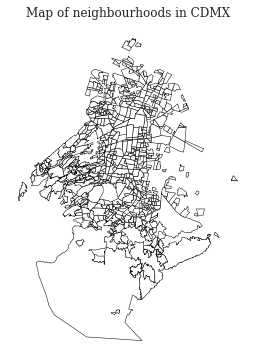

In [238]:
fig, ax = plt.subplots(figsize=(6, 6))
gdf.plot(color = 'white', edgecolor = 'black', ax = ax, linewidth = .5 )
#gdf.centroid.plot(ax = ax)
ax.set_title('Map of neighbourhoods in CDMX', fontsize=12)
ax.axis("off")
plt.show()
gdf.explore()

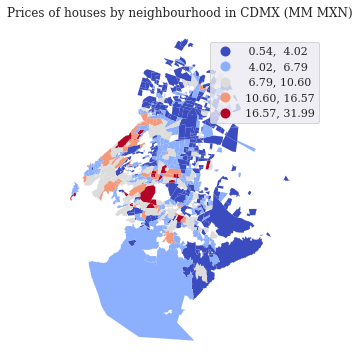

In [226]:

fig, ax = plt.subplots(figsize=(6, 6))
gdf.plot(column='price_small', cmap = 'coolwarm', linewidth=0.01, scheme = 'FisherJenks', k=5, legend=True, legend_kwds={'bbox_to_anchor':(1.10, 0.96)},  ax=ax)
ax.set_title('Prices of houses by neighbourhood in CDMX (MM MXN)', fontsize=12)
ax.axis("off")
plt.show()

# Select variables (y, X) and define coordinates

In [168]:
y = gdf['price_small'].values.reshape((-1,1)) # reshape is needed to have column array
y.shape

(699, 1)

In [169]:
X_df =gdf.drop(['id_right', 'age', 'price_small', 'construction_size', 'geometry', 'price_per_area_small', 'latitude', 'longitude', 'price', 'price_per_area'], axis = 1)
X = X_df.values

min_max_scaler = preprocessing.MinMaxScaler()
X= min_max_scaler.fit_transform(X)

X_df

,bedrooms,bathrooms,half_bathrooms,lot_size,is_house,real_age,balcony,water strorage,air_conditioning,pool,furniture,accasible_for_handicap,first_floor,security,parking_space,kitchen,garden,roof_Garden,service_room,gated_community,high_impact/area,low_impact/area,parks,schools,university,hospital,sport_facility,supermarket,mall,stadium,historic,museum,airport,industry,subway,bus
0,1.607506,3.795655,-0.782058,-0.090367,1.189032,2.965947,-0.280675,-0.319698,-0.078457,-0.178423,-0.060755,-0.124474,-0.037796,-0.292728,-0.30405,1.583125,-0.256962,-0.377890,-0.483958,-0.041937,-0.362235,-0.490653,-1.204725,-0.026416,-0.190933,0.217603,-0.937668,-0.393369,-0.428634,0.059922,-0.030999,0.142419,-0.086261,-0.280822,-0.360175,-0.457558
1,-0.789660,-1.259302,-0.782058,-0.164097,-0.912587,0.167806,-0.280675,-0.319698,-0.078457,-0.178423,-0.060755,-0.124474,-0.037796,-0.292728,-0.30405,1.583125,-0.256962,-0.377890,-0.483958,-0.041937,1.776640,1.564577,-1.733903,0.478983,-0.620477,0.066453,-1.146581,-0.490887,-0.834471,0.076028,-0.273689,-0.313227,-0.352554,-0.992470,-0.777304,-0.857703
2,-1.588716,-1.259302,-0.782058,-0.141148,-0.912587,-1.089330,-0.280675,-0.319698,-0.078457,-0.178423,-0.060755,-0.124474,-0.037796,-0.292728,-0.30405,-1.299618,-0.256962,-0.377890,-0.483958,-0.041937,0.106282,1.299354,0.423617,2.150015,-0.493853,-1.058884,-0.739339,-0.711208,-0.331797,0.405543,-0.918067,-0.833031,-0.101611,0.366546,-0.586630,0.407494
3,5.602784,1.773672,-0.782058,-0.071812,1.189032,-1.089330,-0.280675,-0.319698,-0.078457,-0.178423,-0.060755,-0.124474,-0.037796,-0.292728,-0.30405,1.583125,-0.256962,-0.377890,-0.483958,-0.041937,-0.181528,0.331494,-0.788814,-0.642095,1.123594,0.069091,-0.167126,-0.450806,-0.580005,-0.407965,-0.400672,-0.088077,-1.532088,-0.895682,-0.684277,-0.365462
4,0.009395,-0.248311,-0.782058,-0.089390,1.189032,0.857203,-0.280675,-0.319698,-0.078457,-0.178423,-0.060755,-0.124474,-0.037796,-0.292728,-0.30405,1.583125,-0.256962,-0.377890,-0.483958,-0.041937,1.787594,1.277233,-0.560837,0.465191,-0.118446,-0.554636,-1.216916,-0.175668,-0.721703,0.592396,-0.471636,-0.921843,-0.131758,-0.528284,-0.702726,-0.678414
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
694,0.009395,0.560482,1.531052,0.321350,1.189032,-0.002516,1.553010,-0.319698,-0.078457,-0.178423,-0.060755,-0.124474,-0.037796,-0.292728,-0.30405,-0.723069,-0.256962,1.992182,0.465006,-0.041937,-1.083751,-1.166632,3.268392,0.924926,0.253718,-0.359049,0.924474,0.268487,1.497203,-1.110881,0.981668,1.568479,1.463781,2.170619,1.131246,-0.605667
695,0.009395,0.762681,1.145533,-0.047887,1.189032,-0.764908,-0.280675,3.157024,-0.078457,-0.178423,-0.060755,-0.124474,-0.037796,-0.292728,-0.30405,0.141754,-0.256962,-0.377890,-0.483958,-0.041937,-0.539563,-0.659075,-0.701303,-0.247120,-1.099828,-0.446943,0.503482,-0.350285,-0.811326,-0.702828,-0.623495,-0.368603,0.021319,-0.692475,-0.637533,-0.342341
696,0.808451,0.762681,1.145533,-0.019078,1.189032,1.019414,-0.280675,-0.319698,-0.078457,-0.178423,-0.060755,-0.124474,-0.037796,-0.292728,-0.30405,1.583125,-0.256962,-0.377890,-0.483958,-0.041937,-0.610944,-0.131753,-1.292936,0.684953,-0.942193,-0.829277,0.607015,-0.609447,-0.942246,-0.580451,-1.096245,0.074720,0.046001,-0.401229,-0.435141,-0.669519
697,0.009395,1.268176,1.145533,-0.058141,1.189032,1.546600,-0.280675,-0.319698,-0.078457,-0.178423,-0.060755,-0.124474,-0.037796,-0.292728,-0.30405,0.141754,-0.256962,-0.377890,1.888453,-0.041937,-0.711344,-0.666830,-1.261227,-0.503962,-0.815370,-1.011149,-0.160907,0.056774,-0.746703,0.014316,-0.162428,-0.217427,1.080662,1.123871,0.560929,1.742792


In [170]:
gdf["centroids"] = gdf["geometry"].centroid
u =  gdf["centroids"].x
v =  gdf["centroids"].y
coords = list(zip(u,v))


In [171]:
gdf.centroids.x

0      2.793472e+06
1      2.794483e+06
2      2.792847e+06
3      2.801276e+06
4      2.793442e+06
           ...     
694    2.798141e+06
695    2.800677e+06
696    2.801099e+06
697    2.795124e+06
698    2.792056e+06
Length: 699, dtype: float64

# Test local Autocorrelation   Moran cluster map

In [172]:
#Generating spatial weight matrix
X_df_loc =gdf.drop(['price_small', 'price_per_area_small', 'latitude', 'longitude', 'price', 'price_per_area'], axis = 1).copy()
display(X_df_loc)
# Generate W from the GeoDataFrame
w = weights.distance.KNN.from_dataframe(X_df_loc, k=8)
# Row-standardization
w.transform = "R"
pd.DataFrame(w)



,bedrooms,bathrooms,half_bathrooms,lot_size,construction_size,age,is_house,real_age,balcony,water strorage,air_conditioning,pool,furniture,accasible_for_handicap,first_floor,security,parking_space,kitchen,garden,roof_Garden,service_room,gated_community,high_impact/area,low_impact/area,parks,schools,university,hospital,sport_facility,supermarket,mall,stadium,historic,museum,airport,industry,subway,bus,id_right,geometry,centroids
0,1.607506,3.795655,-0.782058,-0.090367,0.101543,0.274983,1.189032,2.965947,-0.280675,-0.319698,-0.078457,-0.178423,-0.060755,-0.124474,-0.037796,-0.292728,-0.30405,1.583125,-0.256962,-0.377890,-0.483958,-0.041937,-0.362235,-0.490653,-1.204725,-0.026416,-0.190933,0.217603,-0.937668,-0.393369,-0.428634,0.059922,-0.030999,0.142419,-0.086261,-0.280822,-0.360175,-0.457558,8,"MULTIPOLYGON (((2793299.849 832180.730, 279330...",POINT (2793471.544 832294.395)
1,-0.789660,-1.259302,-0.782058,-0.164097,-0.170815,-0.151405,-0.912587,0.167806,-0.280675,-0.319698,-0.078457,-0.178423,-0.060755,-0.124474,-0.037796,-0.292728,-0.30405,1.583125,-0.256962,-0.377890,-0.483958,-0.041937,1.776640,1.564577,-1.733903,0.478983,-0.620477,0.066453,-1.146581,-0.490887,-0.834471,0.076028,-0.273689,-0.313227,-0.352554,-0.992470,-0.777304,-0.857703,16,"MULTIPOLYGON (((2794357.004 830240.705, 279438...",POINT (2794483.270 830330.304)
2,-1.588716,-1.259302,-0.782058,-0.141148,-0.147499,-0.342970,-0.912587,-1.089330,-0.280675,-0.319698,-0.078457,-0.178423,-0.060755,-0.124474,-0.037796,-0.292728,-0.30405,-1.299618,-0.256962,-0.377890,-0.483958,-0.041937,0.106282,1.299354,0.423617,2.150015,-0.493853,-1.058884,-0.739339,-0.711208,-0.331797,0.405543,-0.918067,-0.833031,-0.101611,0.366546,-0.586630,0.407494,33,"MULTIPOLYGON (((2792835.890 828193.326, 279284...",POINT (2792847.230 827937.598)
3,5.602784,1.773672,-0.782058,-0.071812,0.169013,-0.342970,1.189032,-1.089330,-0.280675,-0.319698,-0.078457,-0.178423,-0.060755,-0.124474,-0.037796,-0.292728,-0.30405,1.583125,-0.256962,-0.377890,-0.483958,-0.041937,-0.181528,0.331494,-0.788814,-0.642095,1.123594,0.069091,-0.167126,-0.450806,-0.580005,-0.407965,-0.400672,-0.088077,-1.532088,-0.895682,-0.684277,-0.365462,34,"MULTIPOLYGON (((2801132.447 826978.129, 280115...",POINT (2801276.300 826921.114)
4,0.009395,-0.248311,-0.782058,-0.089390,-0.104834,-0.046353,1.189032,0.857203,-0.280675,-0.319698,-0.078457,-0.178423,-0.060755,-0.124474,-0.037796,-0.292728,-0.30405,1.583125,-0.256962,-0.377890,-0.483958,-0.041937,1.787594,1.277233,-0.560837,0.465191,-0.118446,-0.554636,-1.216916,-0.175668,-0.721703,0.592396,-0.471636,-0.921843,-0.131758,-0.528284,-0.702726,-0.678414,35,"MULTIPOLYGON (((2793254.156 830422.310, 279325...",POINT (2793441.628 830458.857)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
694,0.009395,0.560482,1.531052,0.321350,0.125157,-0.177359,1.189032,-0.002516,1.553010,-0.319698,-0.078457,-0.178423,-0.060755,-0.124474,-0.037796,-0.292728,-0.30405,-0.723069,-0.256962,1.992182,0.465006,-0.041937,-1.083751,-1.166632,3.268392,0.924926,0.253718,-0.359049,0.924474,0.268487,1.497203,-1.110881,0.981668,1.568479,1.463781,2.170619,1.131246,-0.605667,1559,"MULTIPOLYGON (((2796977.276 808648.302, 279697...",POINT (2798141.268 808045.708)
695,0.009395,0.762681,1.145533,-0.047887,0.000835,-0.293534,1.189032,-0.764908,-0.280675,3.157024,-0.078457,-0.178423,-0.060755,-0.124474,-0.037796,-0.292728,-0.30405,0.141754,-0.256962,-0.377890,-0.483958,-0.041937,-0.539563,-0.659075,-0.701303,-0.247120,-1.099828,-0.446943,0.503482,-0.350285,-0.811326,-0.702828,-0.623495,-0.368603,0.021319,-0.692475,-0.637533,-0.342341,1561,"MULTIPOLYGON (((2800395.769 816279.216, 280039...",POINT (2800676.582 816323.980)
696,0.808451,0.762681,1.145533,-0.019078,0.075746,-0.021635,1.189032,1.019414,-0.280675,-0.319698,-0.078457,-0.178423,-0.060755,-0.124474,-0.037796,-0.292728,-0.30405,1.583125,-0.256962,-0.3778

,0,1
0,0,"{29: 0.125, 303: 0.125, 574: 0.125, 678: 0.125..."
1,1,"{5: 0.125, 516: 0.125, 306: 0.125, 6: 0.125, 1..."
2,2,"{416: 0.125, 157: 0.125, 311: 0.125, 299: 0.12..."
3,3,"{101: 0.125, 247: 0.125, 33: 0.125, 208: 0.125..."
4,4,"{572: 0.125, 13: 0.125, 49: 0.125, 74: 0.125, ..."
...,...,...
694,694,"{639: 0.125, 281: 0.125, 608: 0.125, 494: 0.12..."
695,695,"{374: 0.125, 472: 0.125, 696: 0.125, 436: 0.12..."
696,696,"{436: 0.125, 695: 0.125, 374: 0.125, 410: 0.12..."
697,697,"{672: 0.125, 603: 0.125, 643: 0.125, 658: 0.12..."


['bedrooms', 'bathrooms', 'half_bathrooms', 'lot_size', 'construction_size', 'age', 'is_house', 'real_age', 'balcony', 'water strorage', 'air_conditioning', 'pool', 'furniture', 'accasible_for_handicap', 'first_floor', 'security', 'parking_space', 'kitchen', 'garden', 'roof_Garden', 'service_room', 'gated_community', 'high_impact/area', 'low_impact/area', 'parks', 'schools', 'university', 'hospital', 'sport_facility', 'supermarket', 'mall', 'stadium', 'historic', 'museum', 'airport', 'industry', 'subway', 'bus', 'w_bedrooms', 'w_bathrooms', 'w_half_bathrooms', 'w_lot_size', 'w_construction_size', 'w_age', 'w_is_house', 'w_real_age', 'w_balcony', 'w_water strorage', 'w_air_conditioning', 'w_pool', 'w_furniture', 'w_accasible_for_handicap', 'w_first_floor', 'w_security', 'w_parking_space', 'w_kitchen', 'w_garden', 'w_roof_Garden', 'w_service_room', 'w_gated_community', 'w_high_impact/area', 'w_low_impact/area', 'w_parks', 'w_schools', 'w_university', 'w_hospital', 'w_sport_facility', 'w_

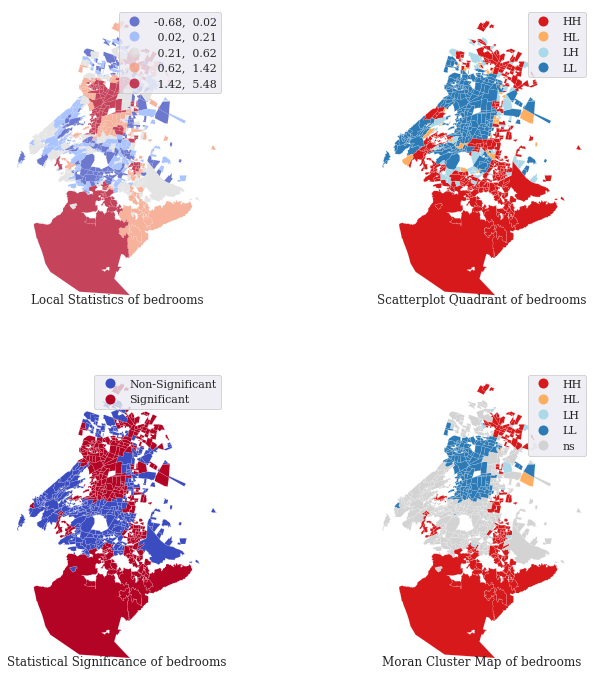

Variable:  bathrooms


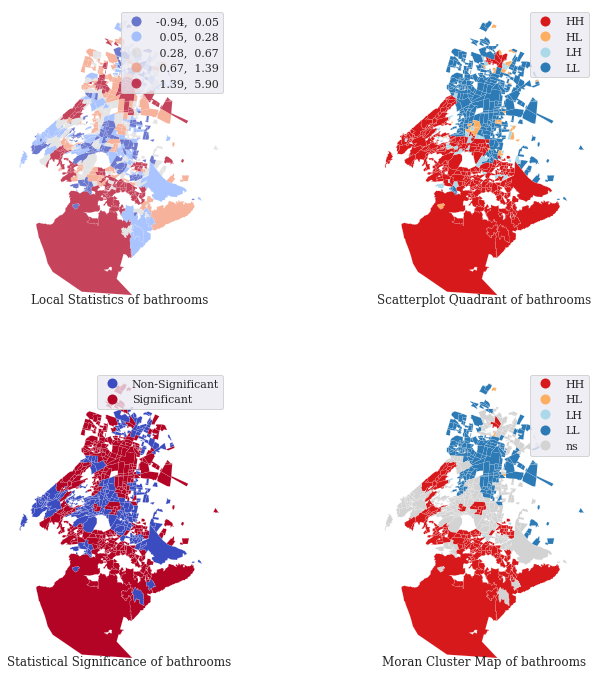

Variable:  half_bathrooms


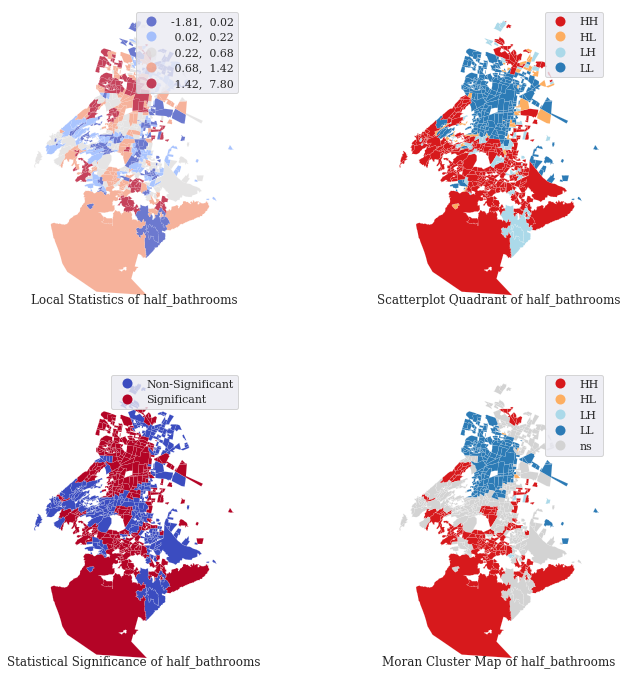

Variable:  lot_size


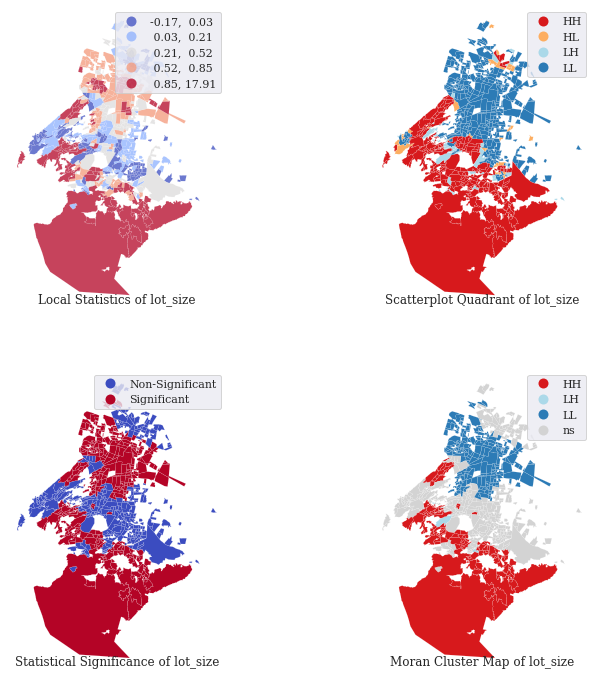

Variable:  construction_size


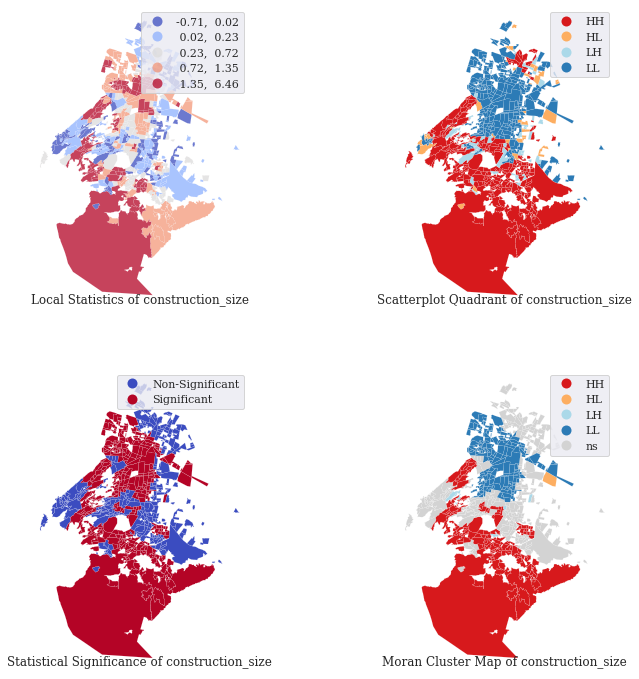

Variable:  age


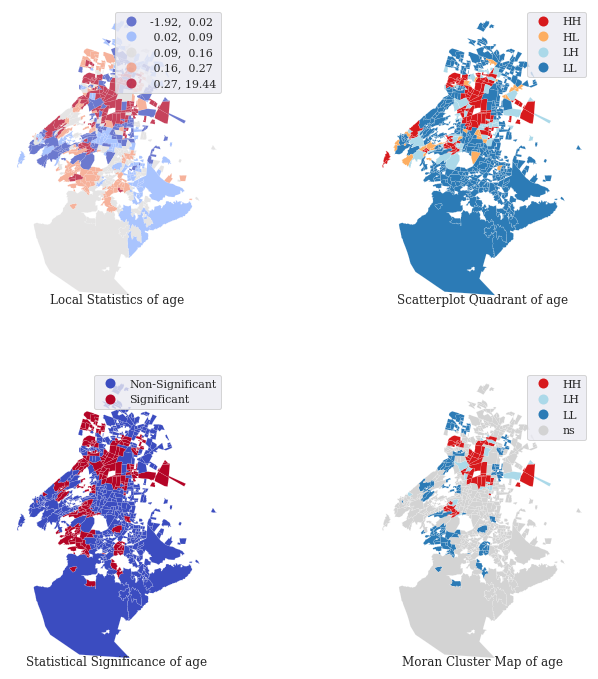

Variable:  is_house


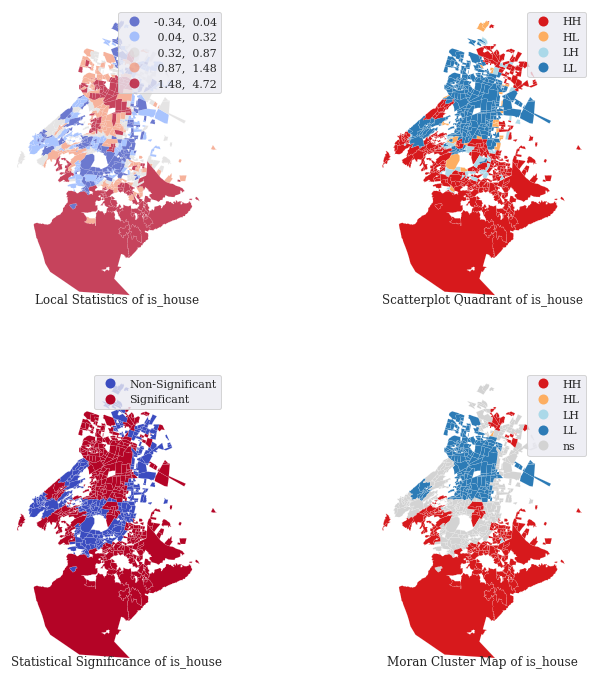

Variable:  real_age


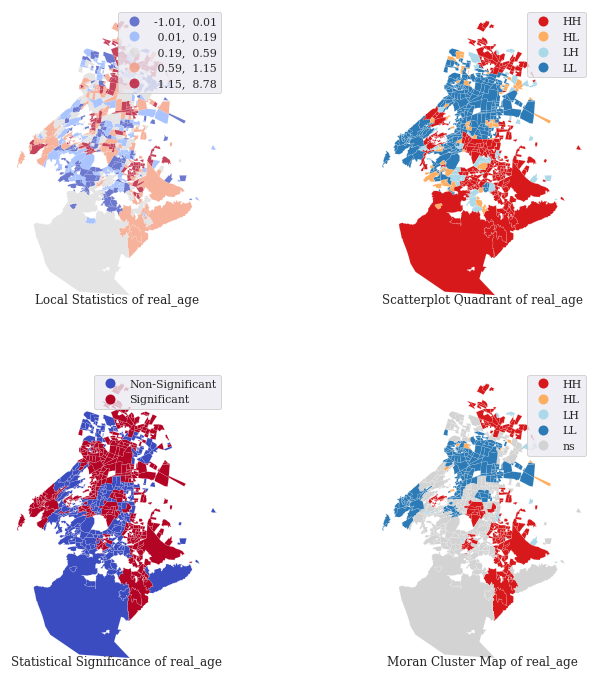

Variable:  balcony


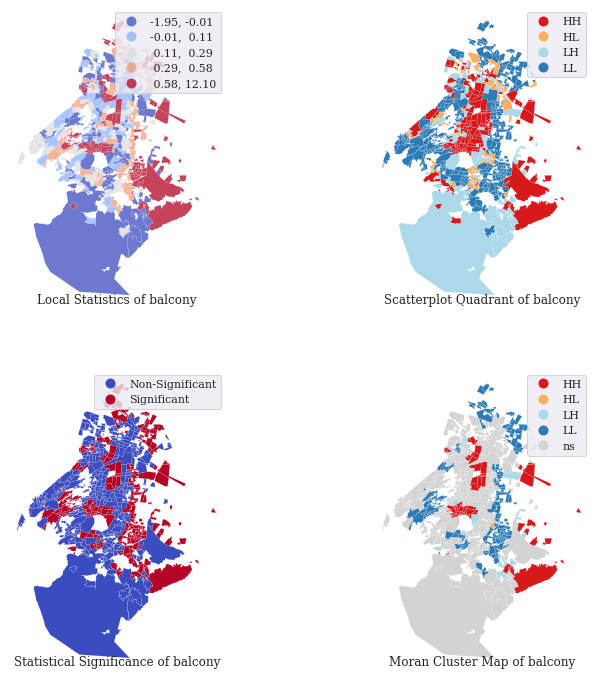

Variable:  water strorage


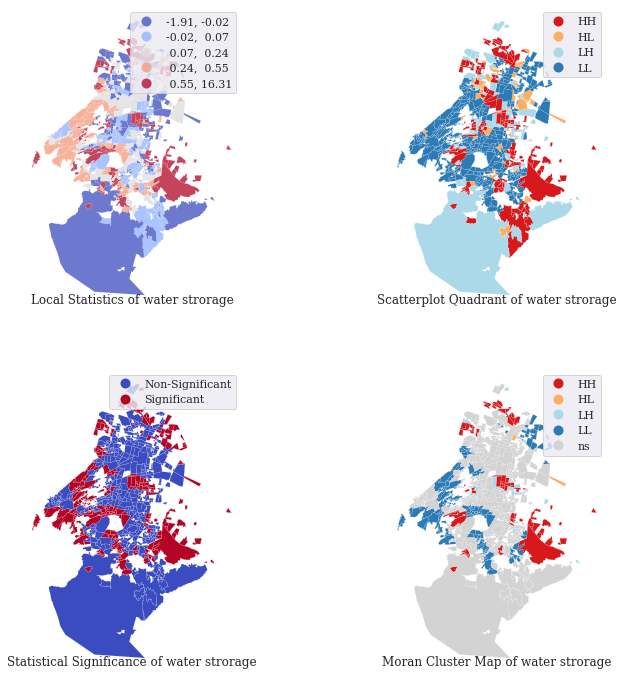

Variable:  air_conditioning


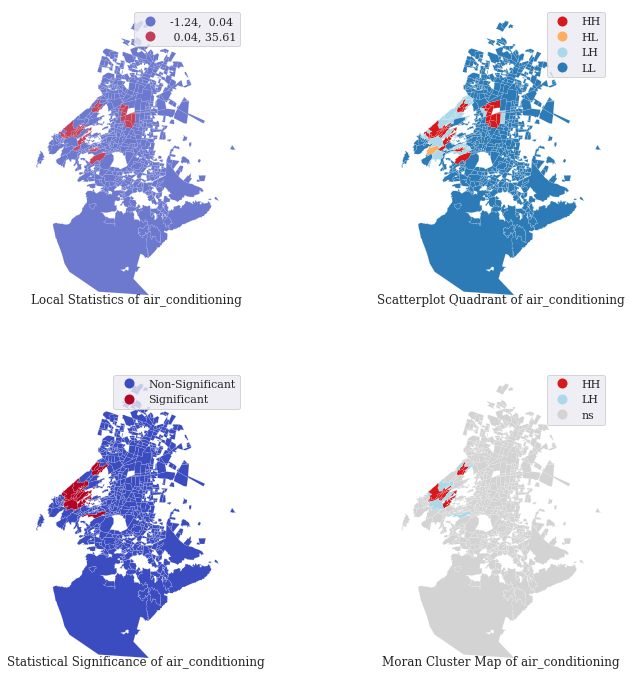

Variable:  pool


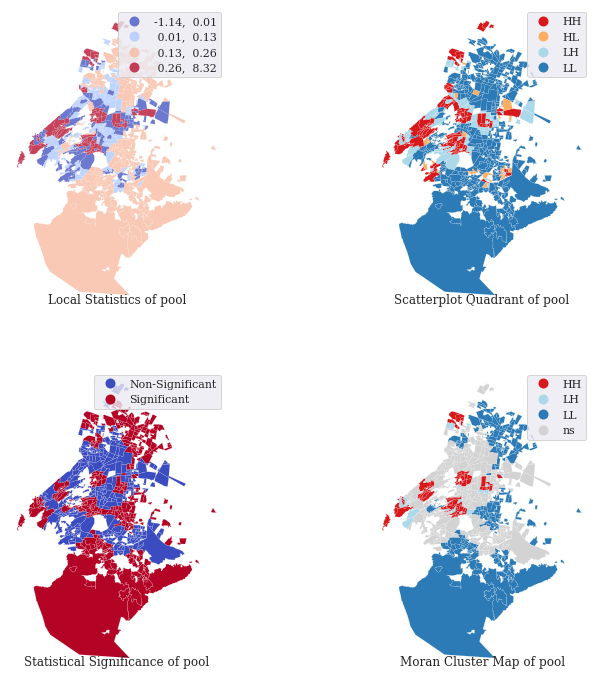

Variable:  furniture


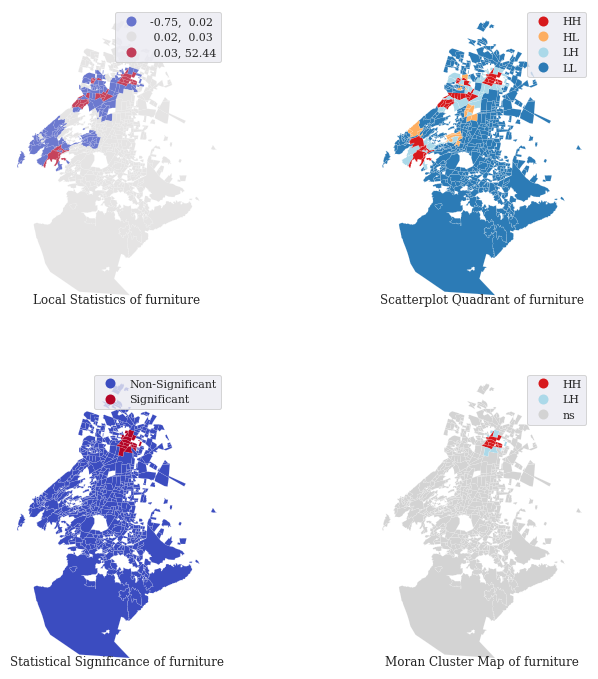

Variable:  accasible_for_handicap


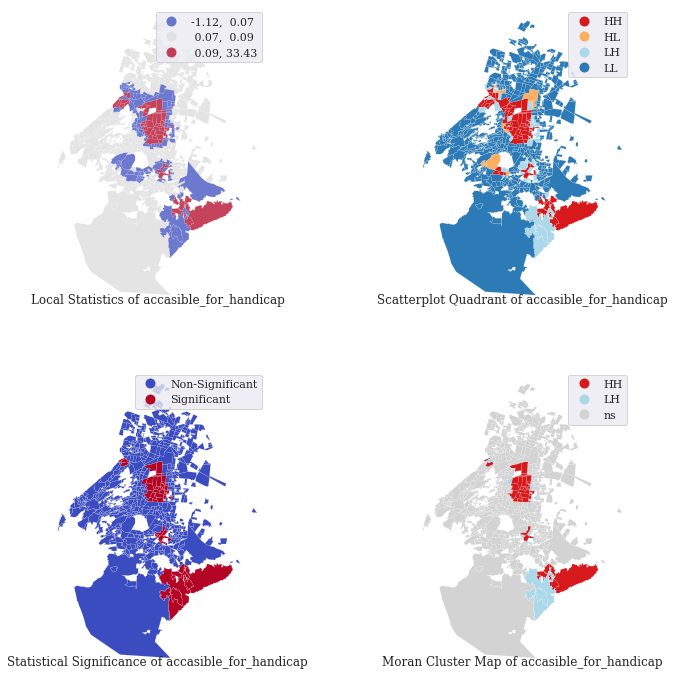

Variable:  first_floor


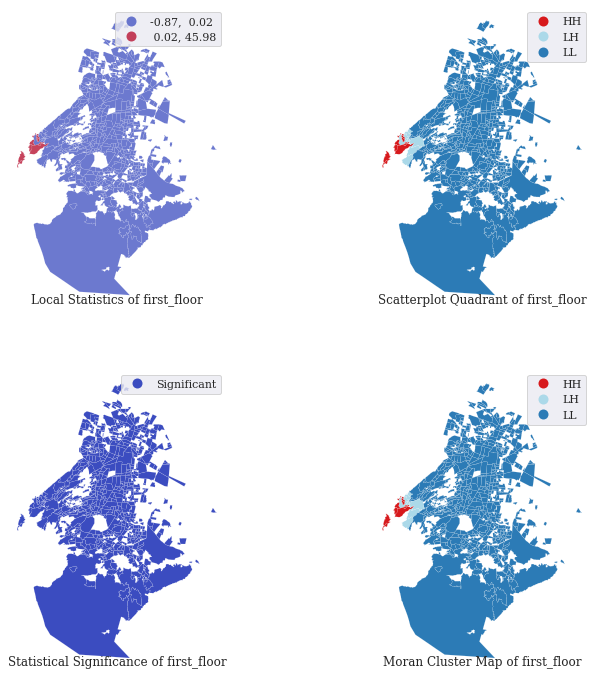

Variable:  security


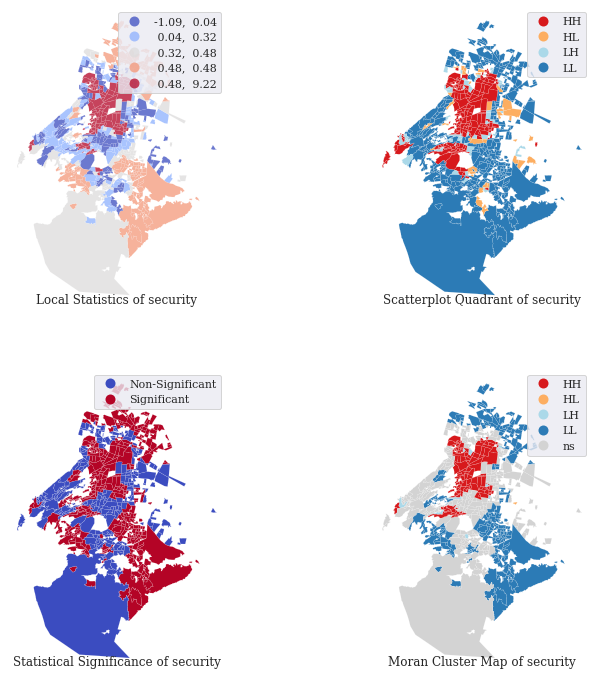

Variable:  parking_space


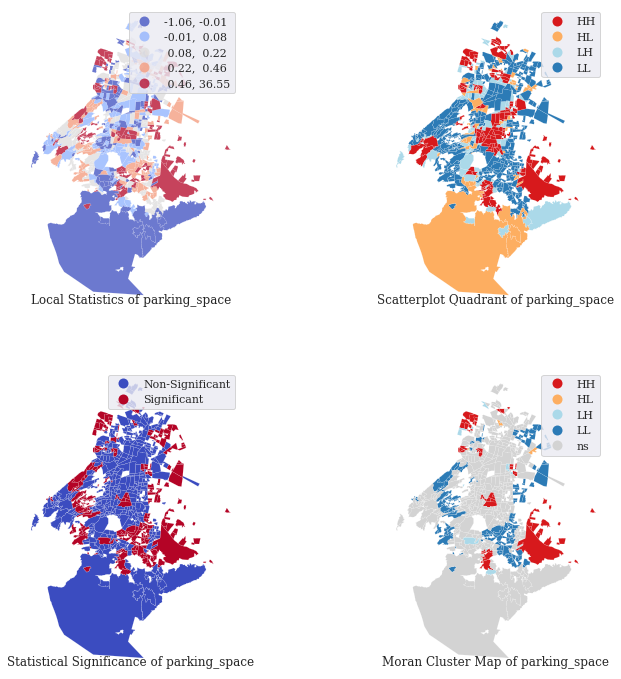

Variable:  kitchen


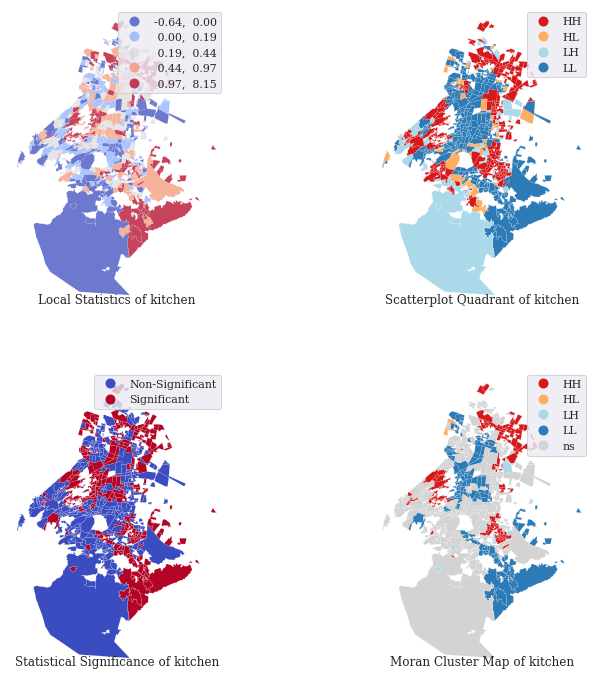

Variable:  garden


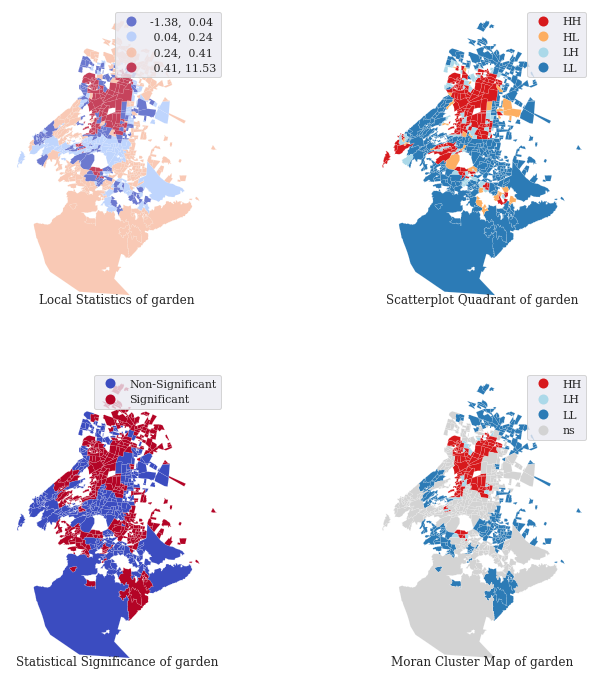

Variable:  roof_Garden


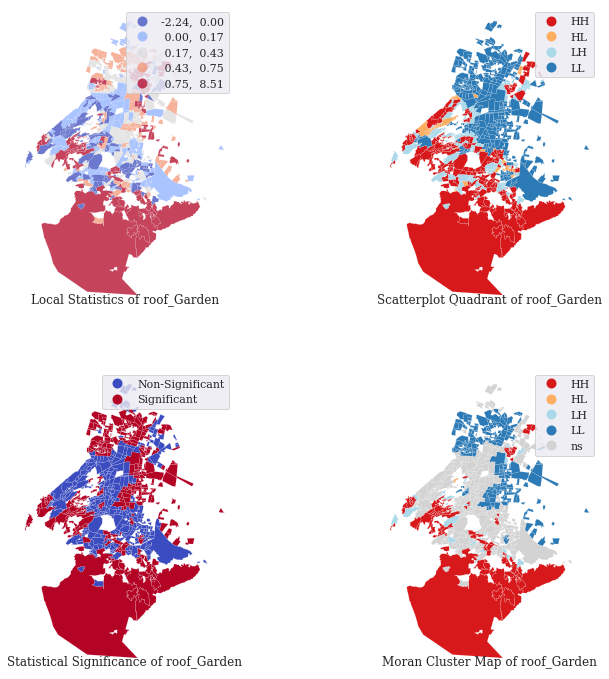

Variable:  service_room


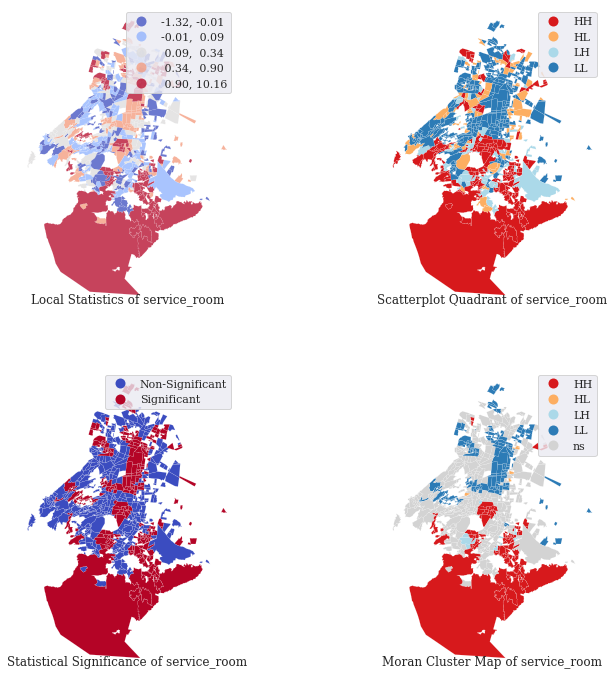

Variable:  gated_community


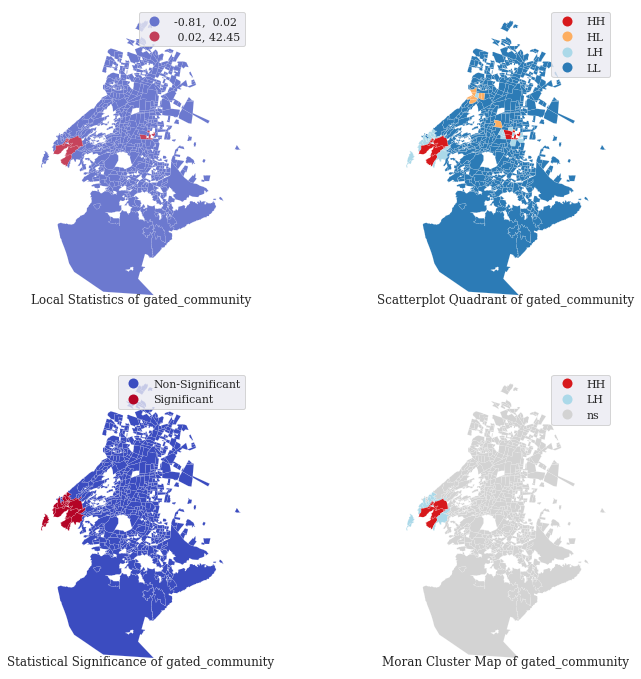

Variable:  high_impact/area


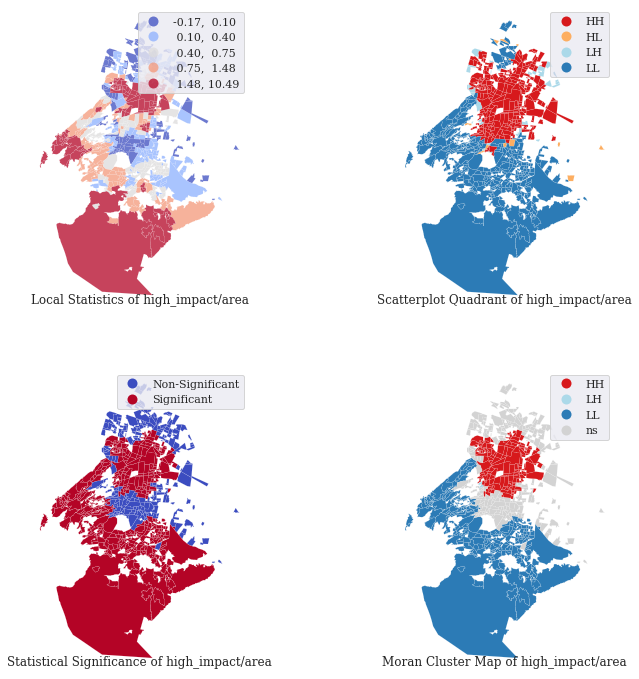

Variable:  low_impact/area


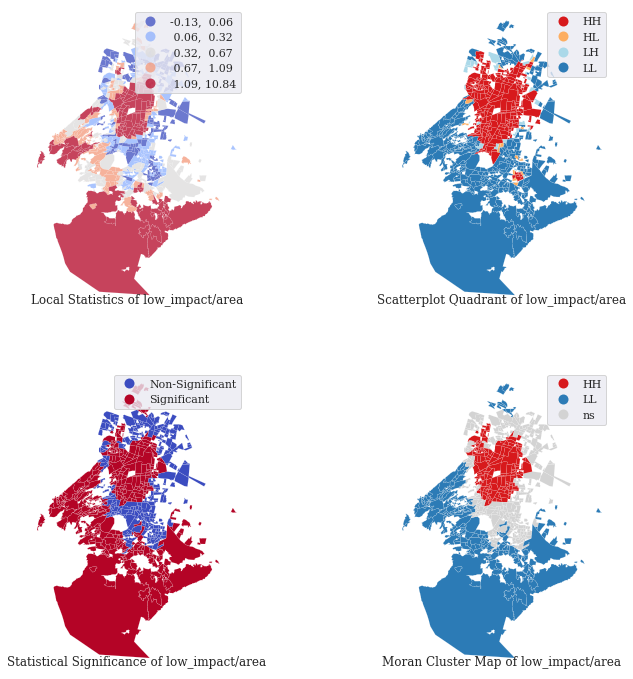

Variable:  parks


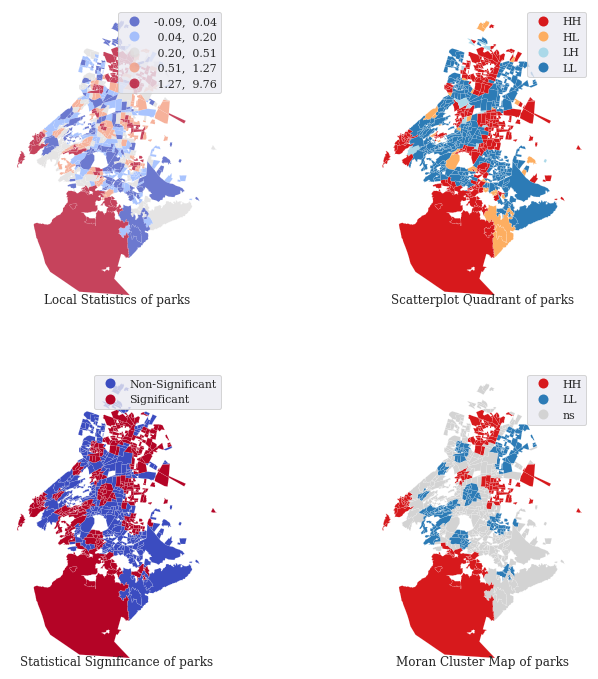

Variable:  schools


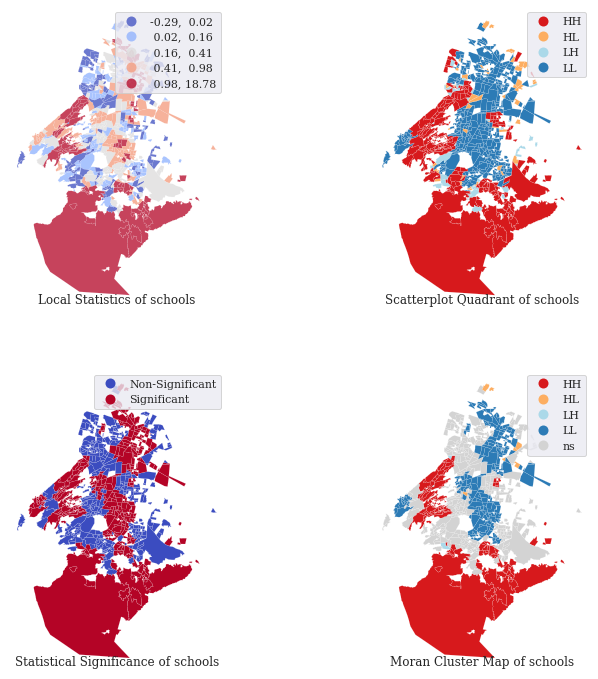

Variable:  university


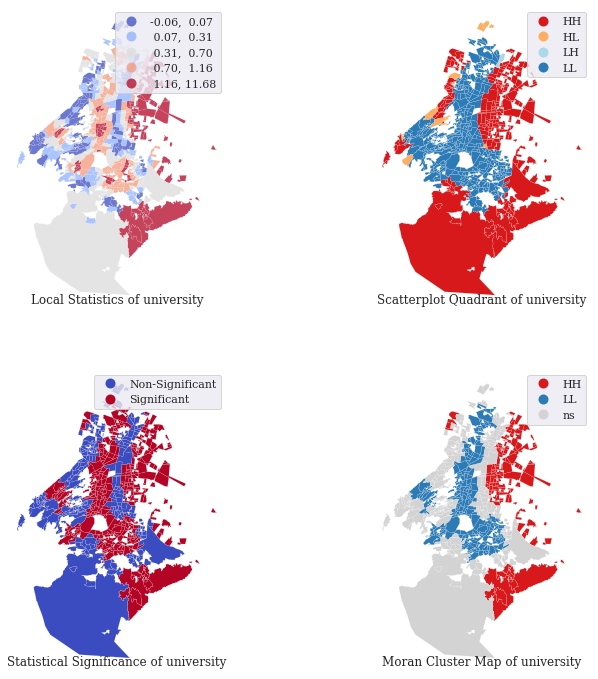

Variable:  hospital


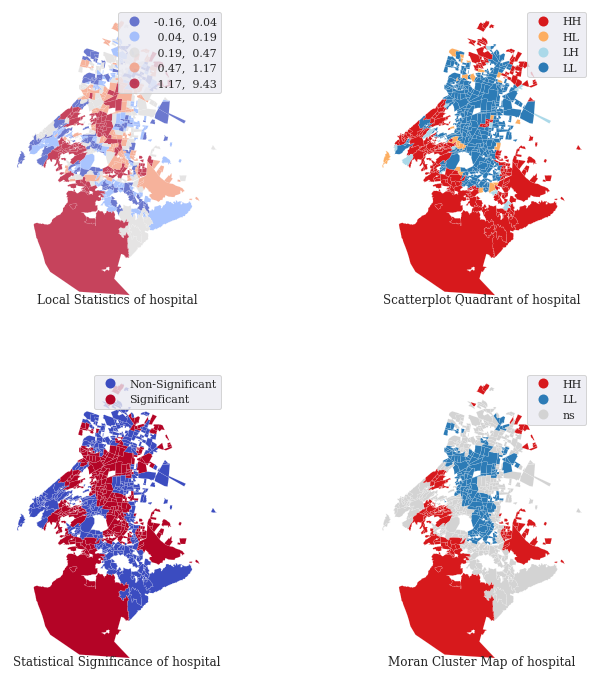

Variable:  sport_facility


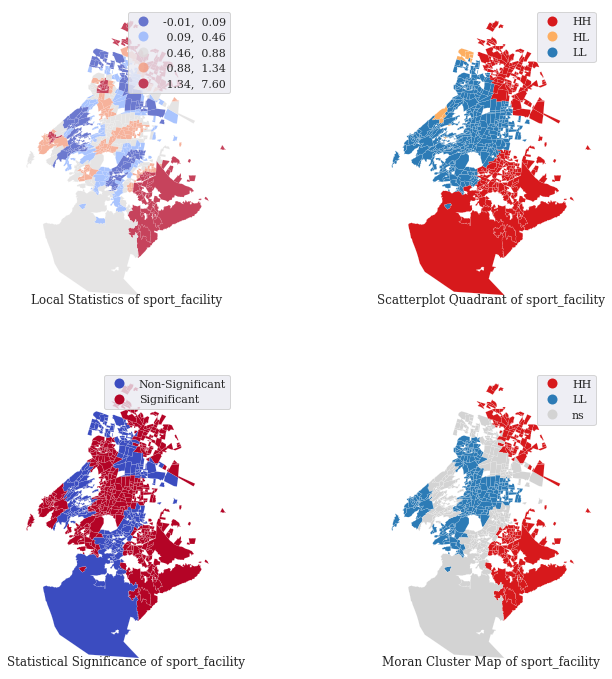

Variable:  supermarket


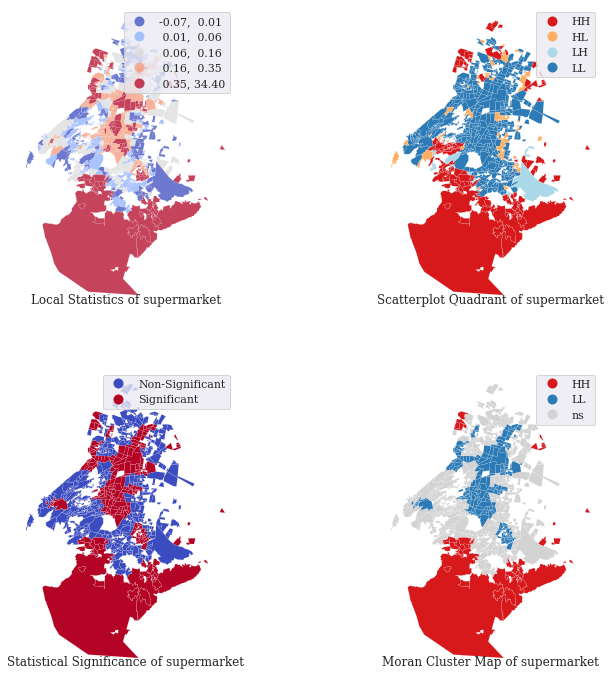

Variable:  mall


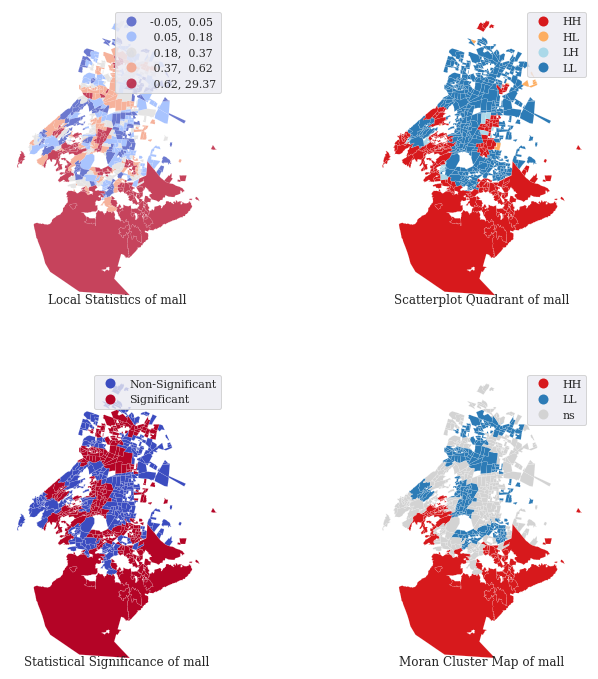

Variable:  stadium


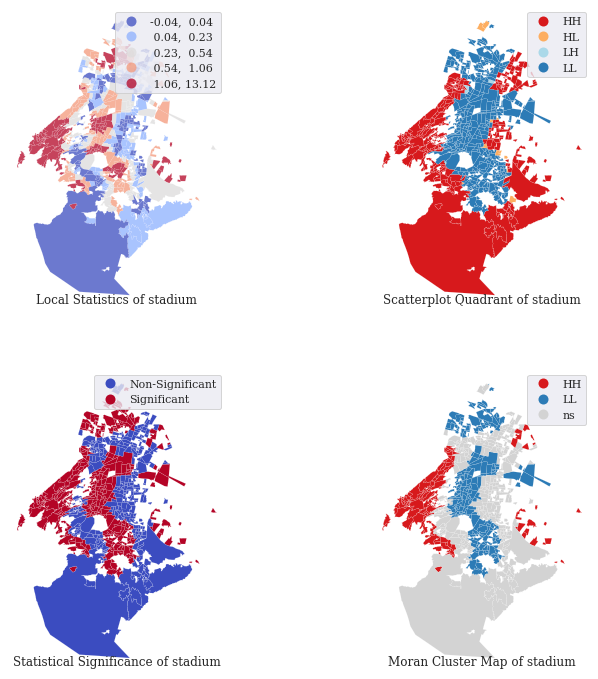

Variable:  historic


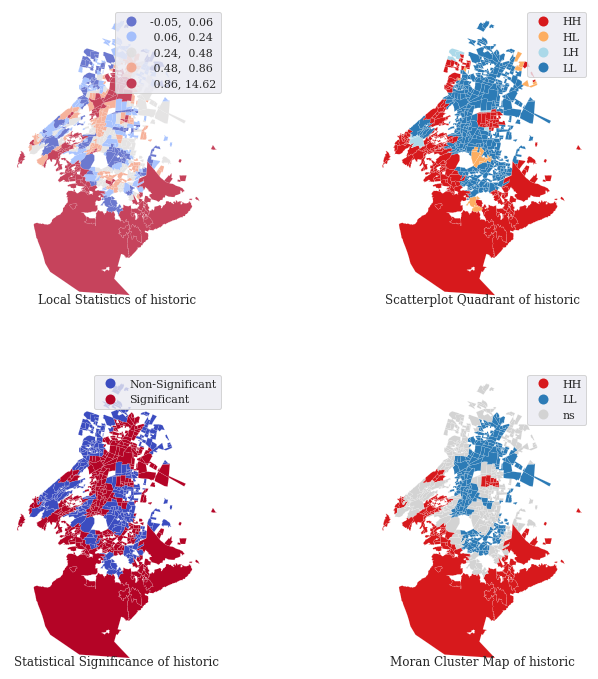

Variable:  museum


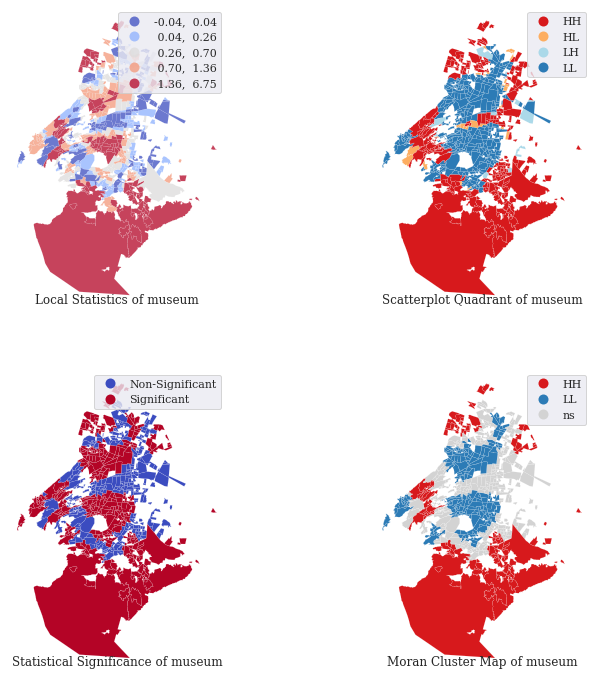

Variable:  airport


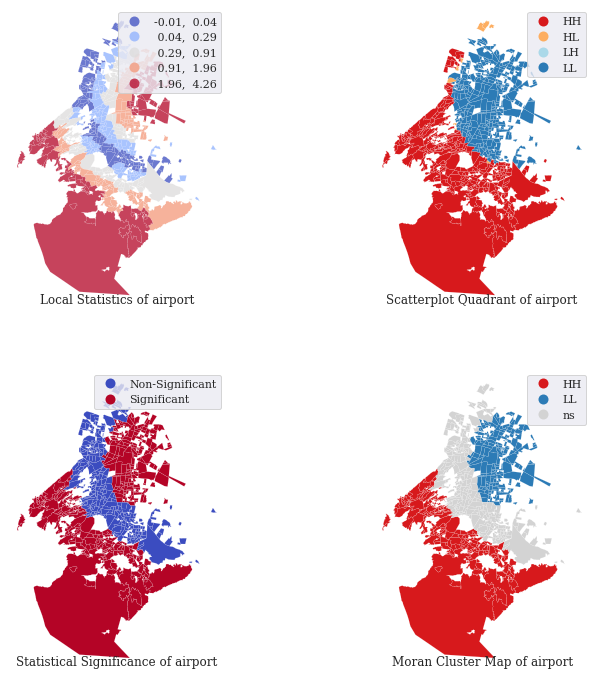

Variable:  industry


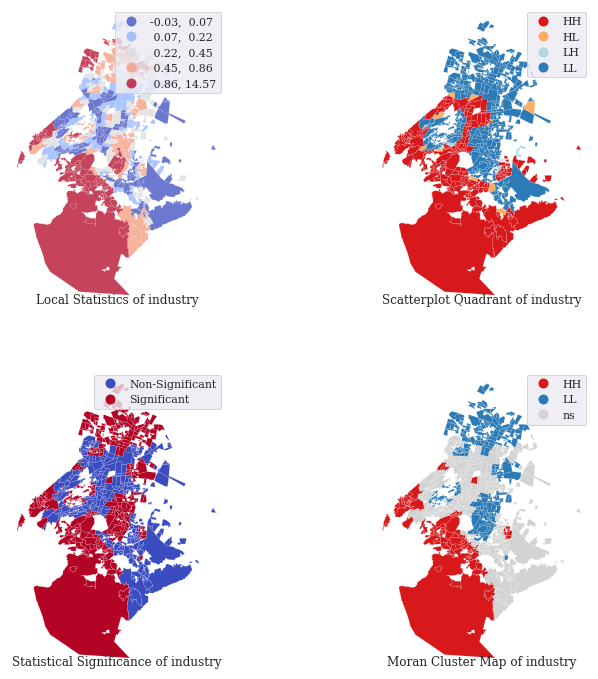

Variable:  subway


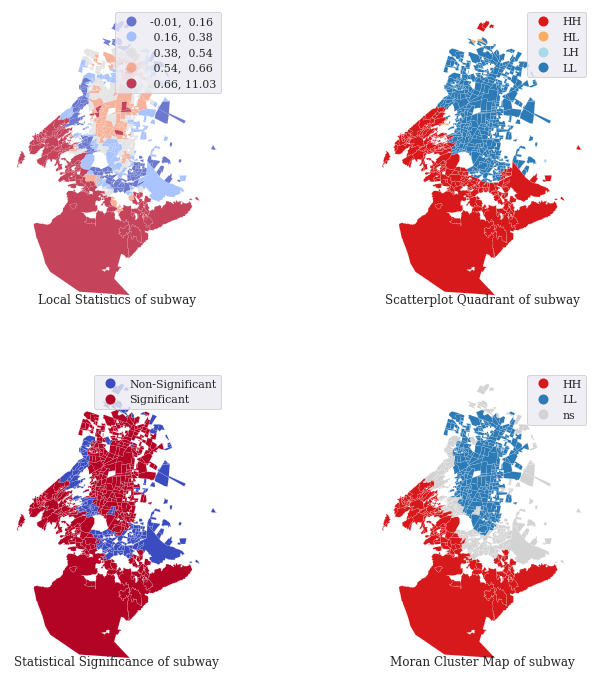

Variable:  bus


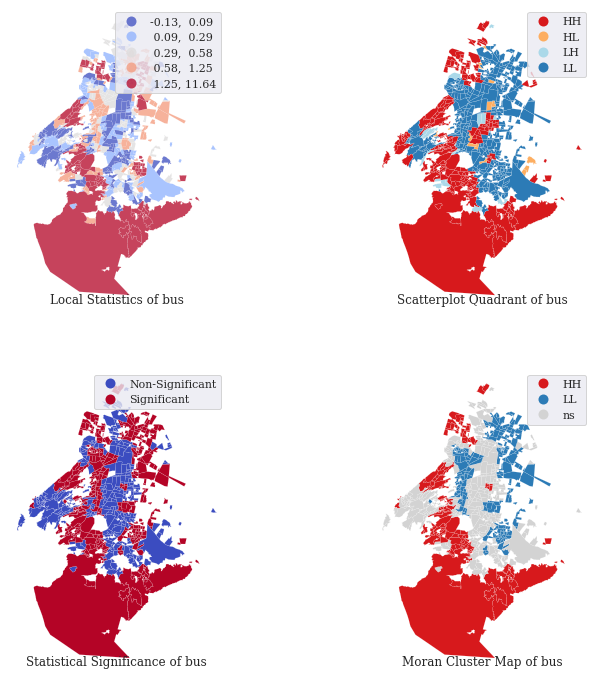

Variable:  w_bedrooms


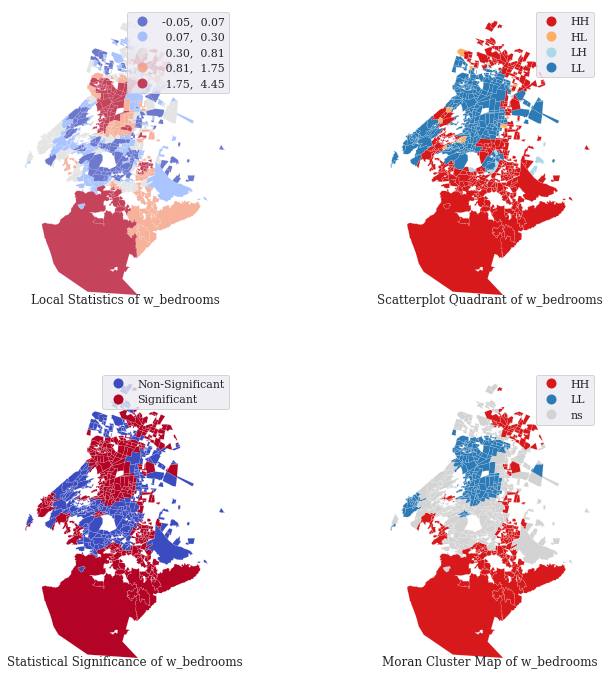

Variable:  w_bathrooms


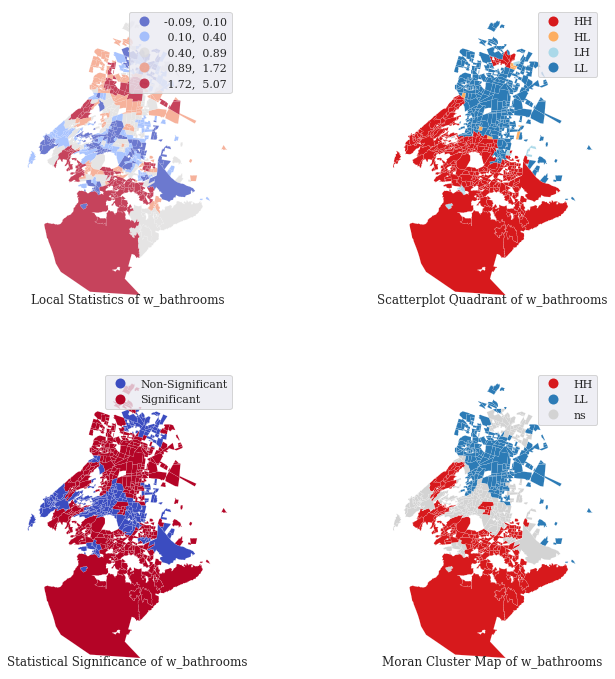

Variable:  w_half_bathrooms


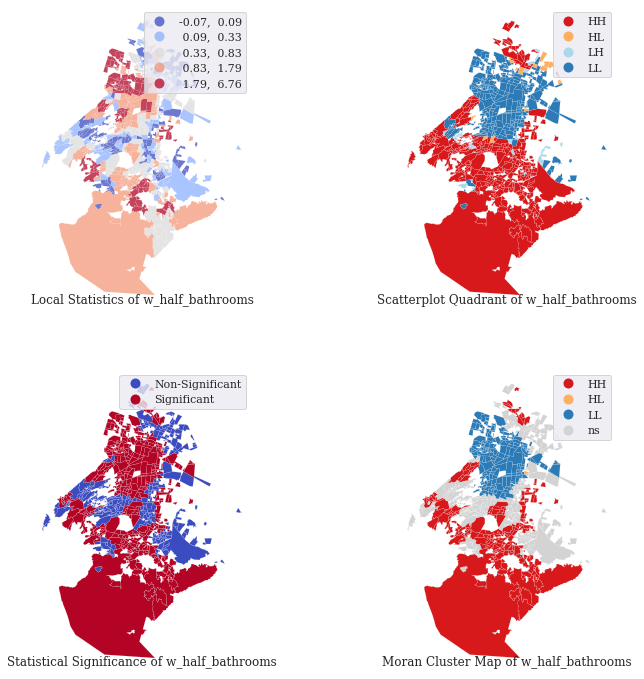

Variable:  w_lot_size


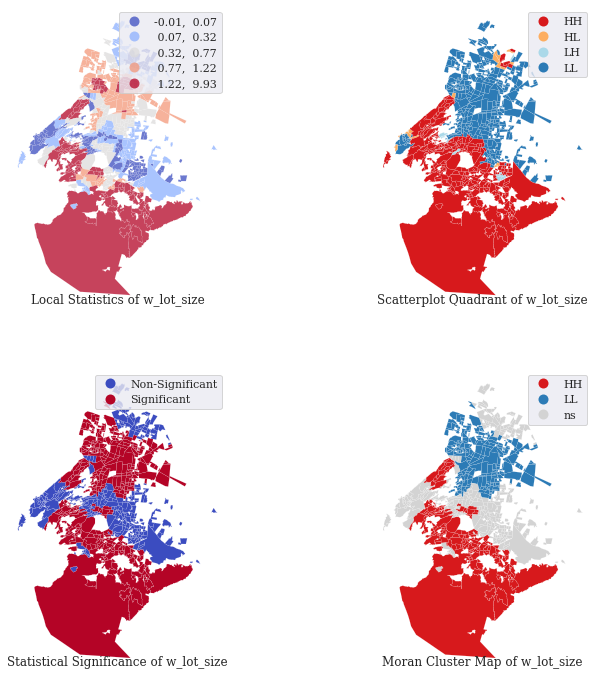

Variable:  w_construction_size


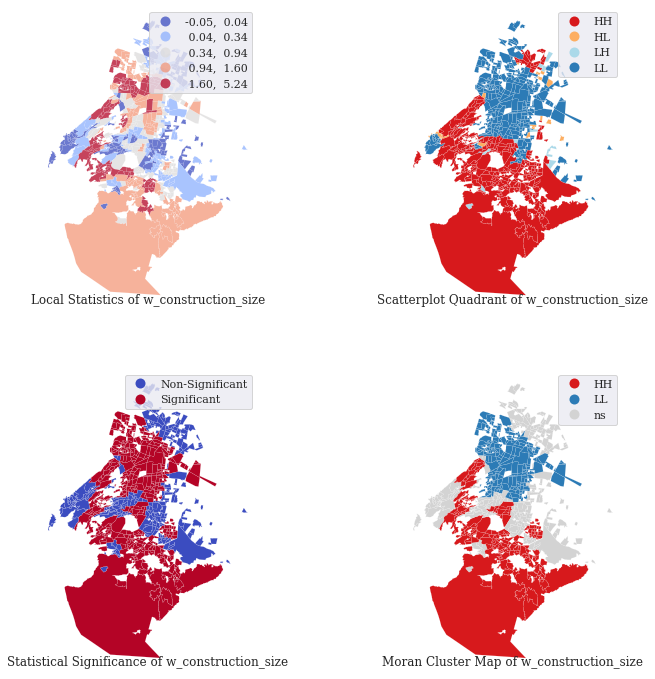

Variable:  w_age


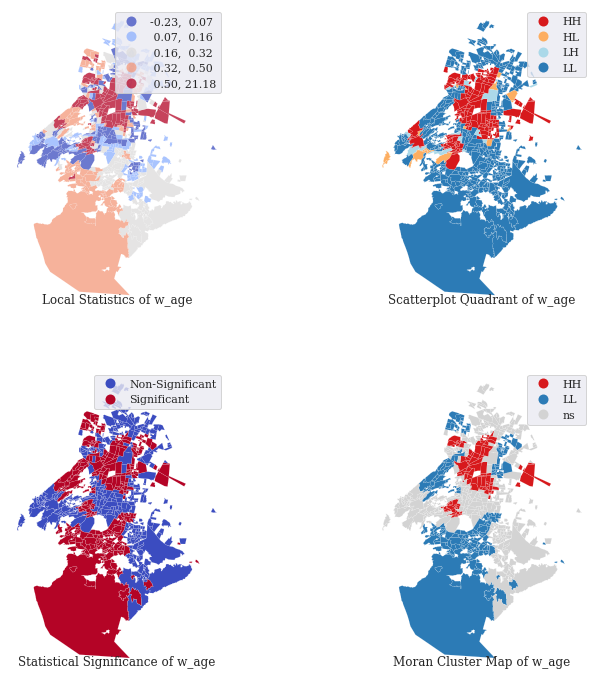

Variable:  w_is_house


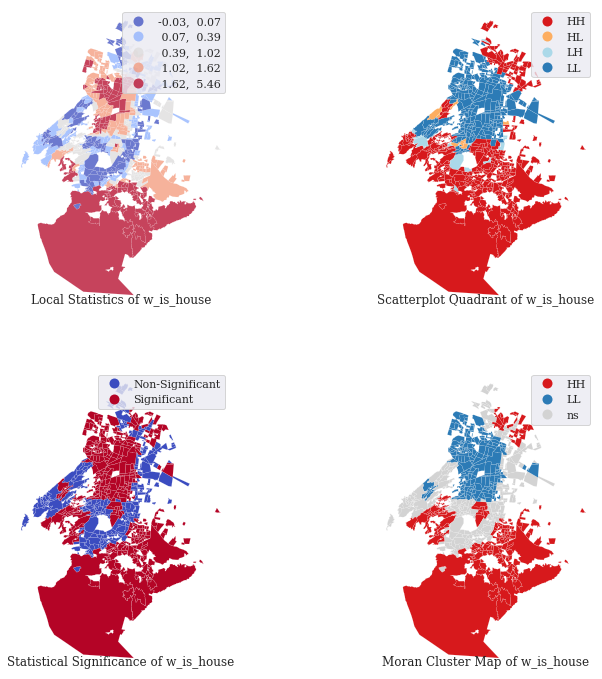

Variable:  w_real_age


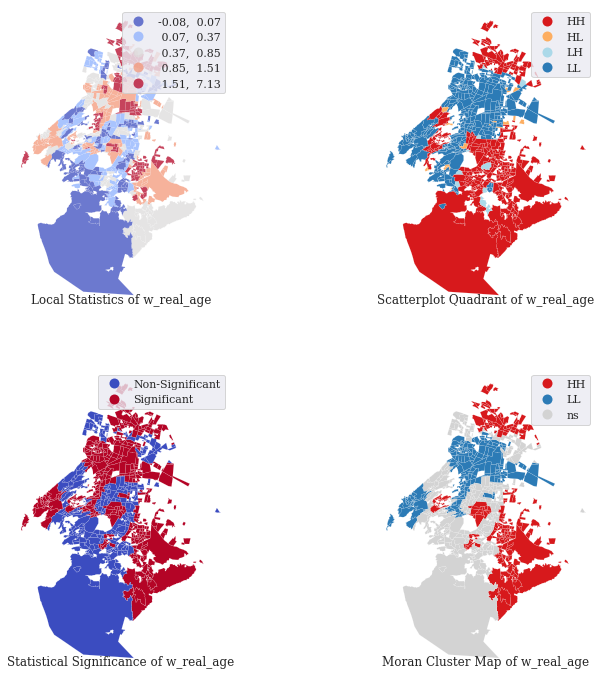

Variable:  w_balcony


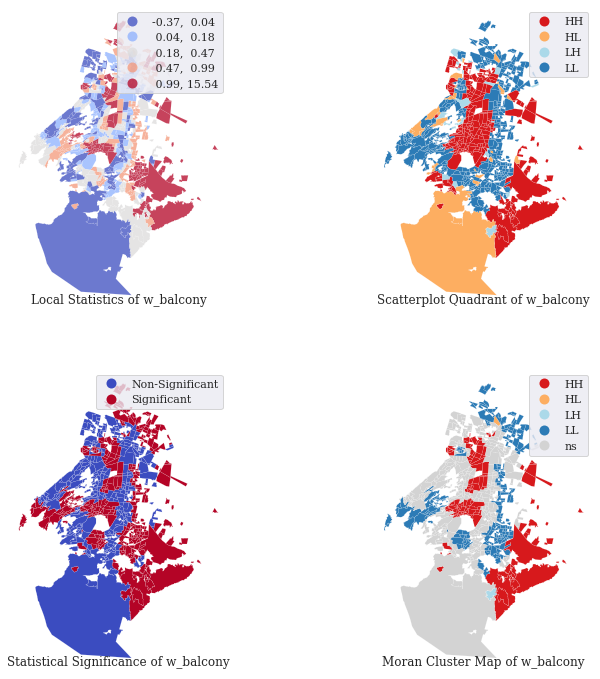

Variable:  w_water strorage


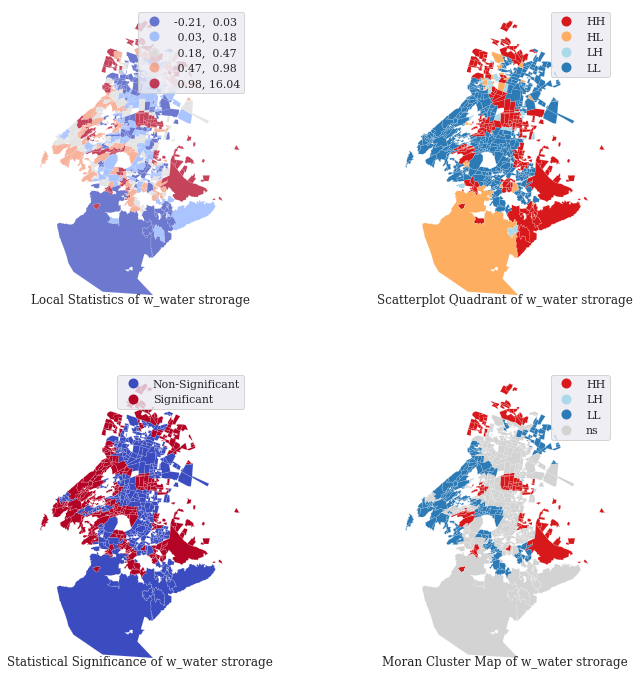

Variable:  w_air_conditioning


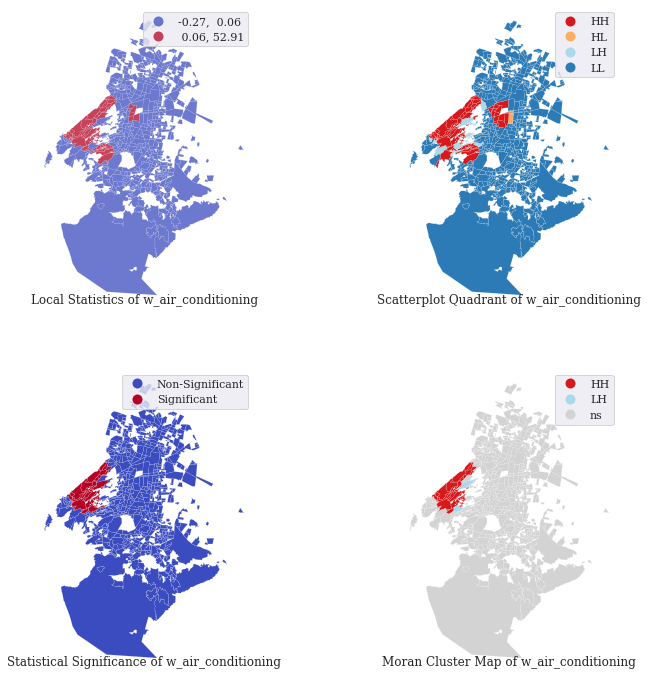

Variable:  w_pool


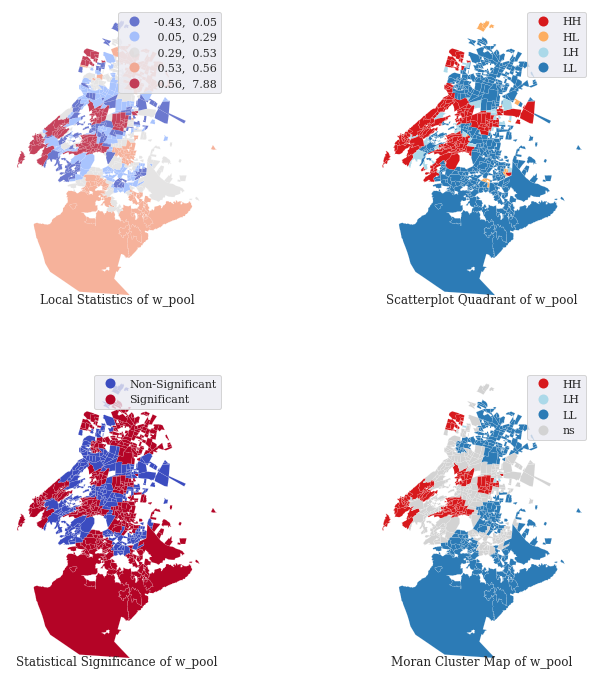

Variable:  w_furniture


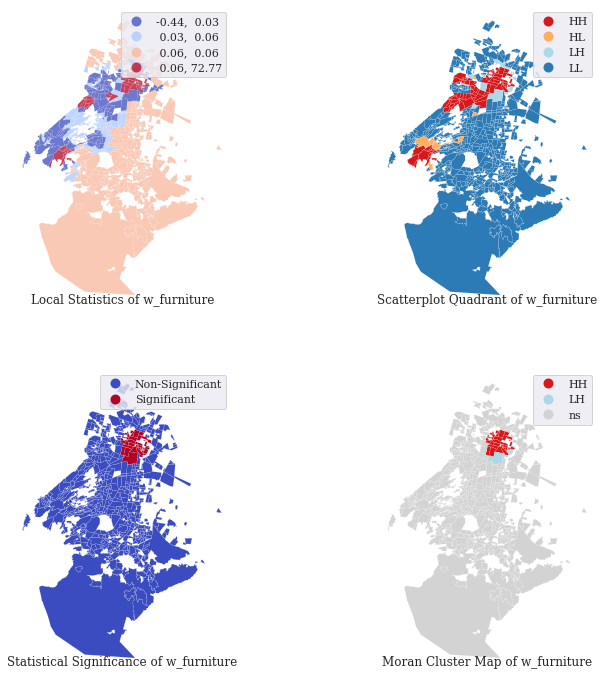

Variable:  w_accasible_for_handicap


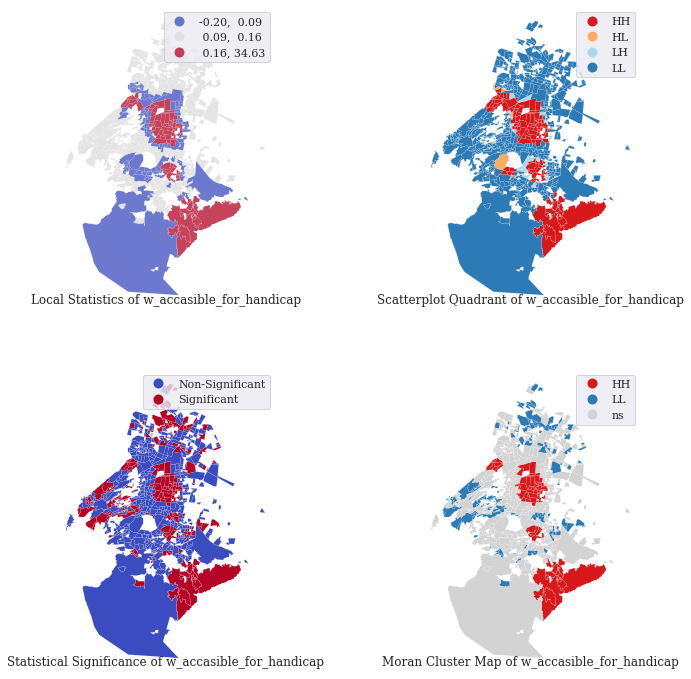

Variable:  w_first_floor


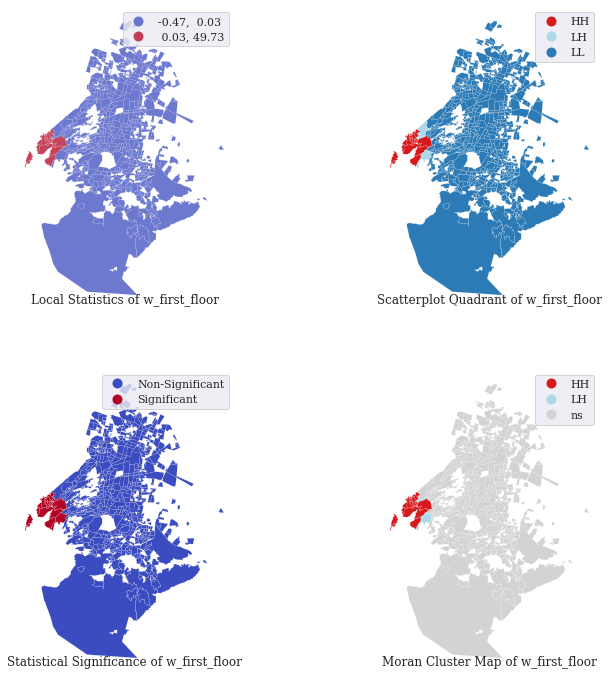

Variable:  w_security


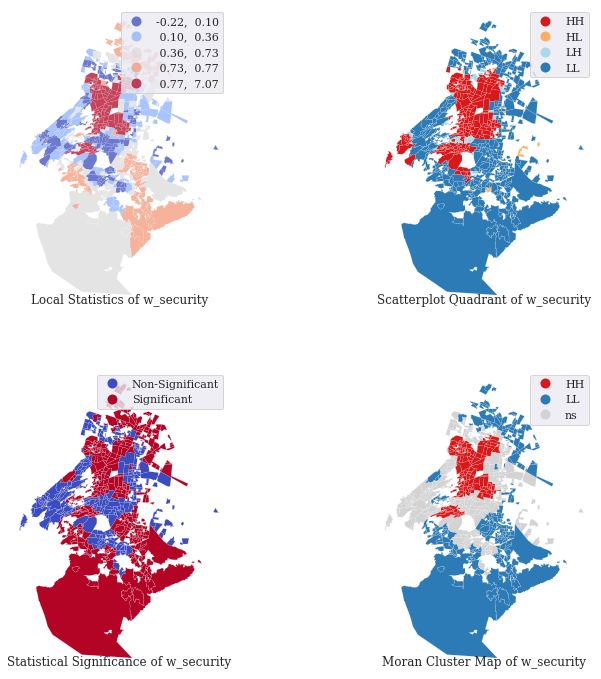

Variable:  w_parking_space


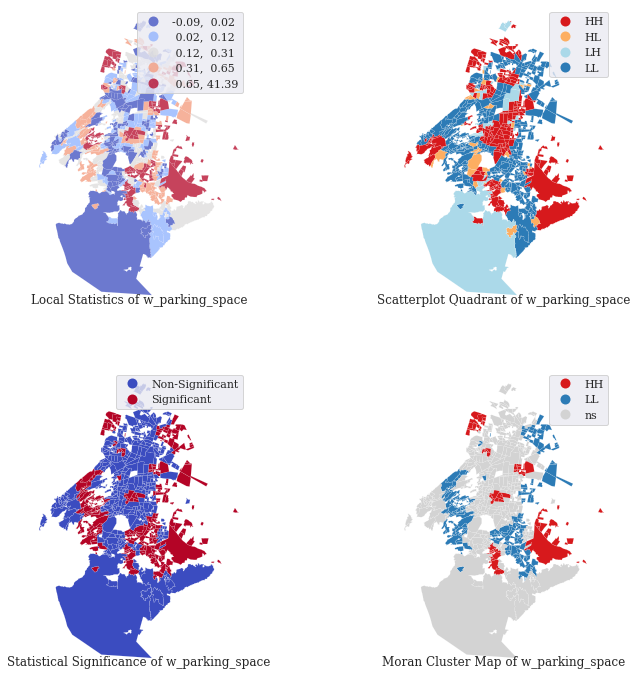

Variable:  w_kitchen


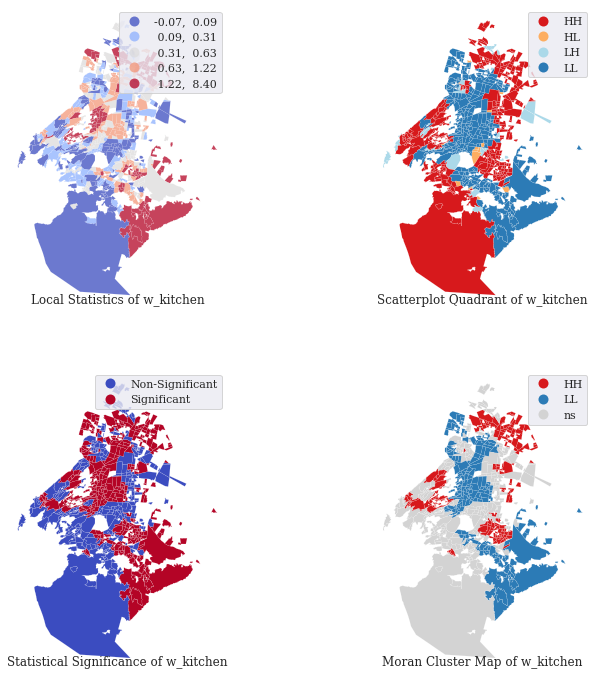

Variable:  w_garden


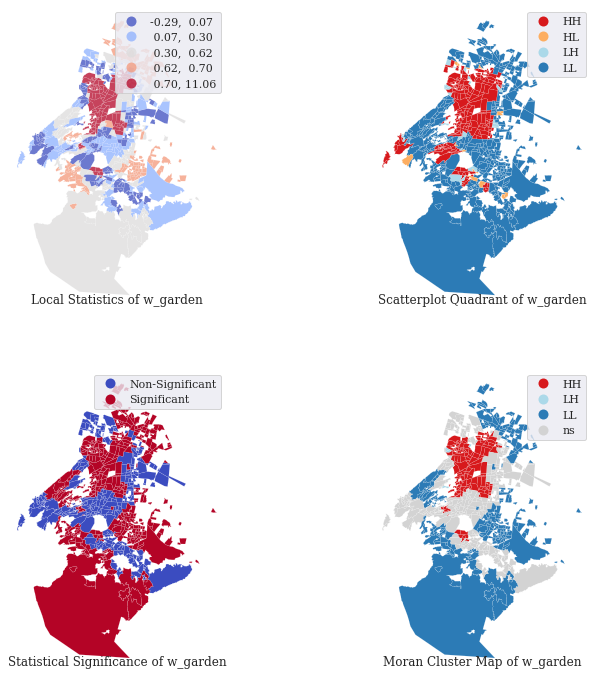

Variable:  w_roof_Garden


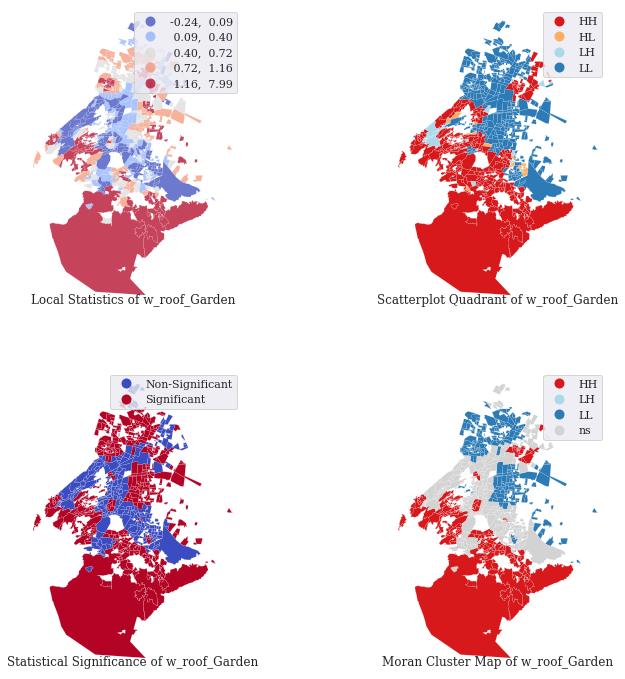

Variable:  w_service_room


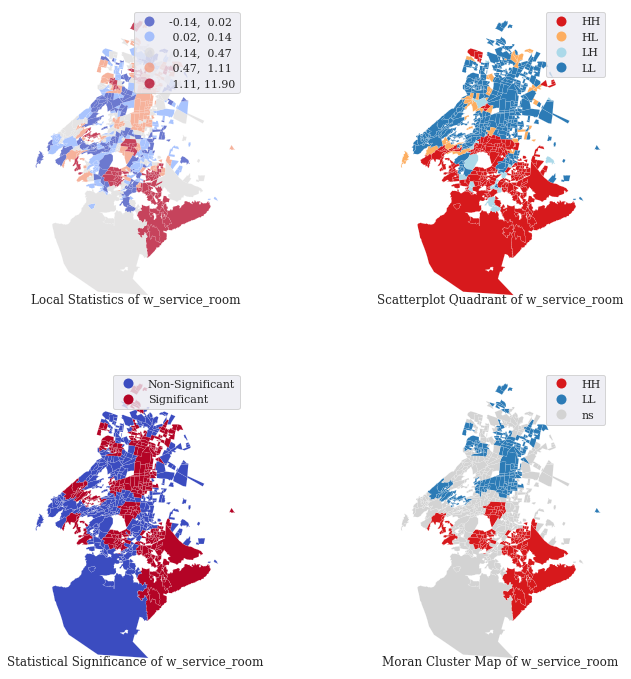

Variable:  w_gated_community


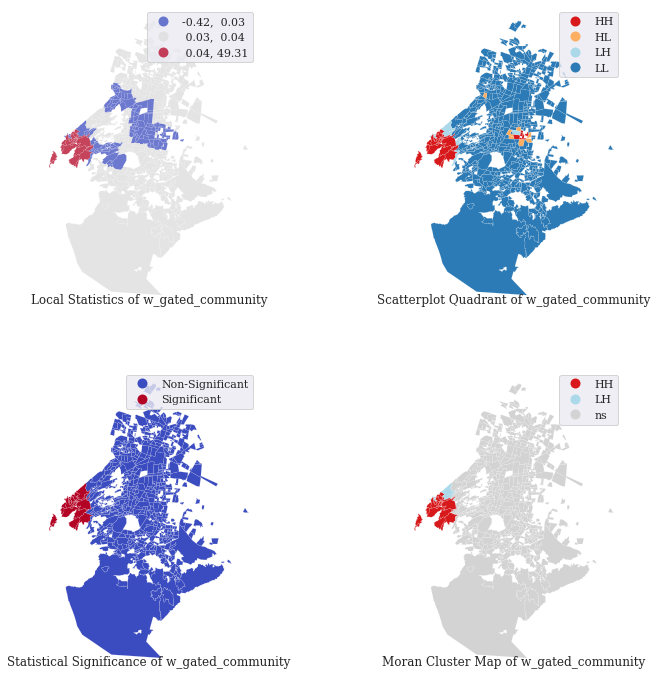

Variable:  w_high_impact/area


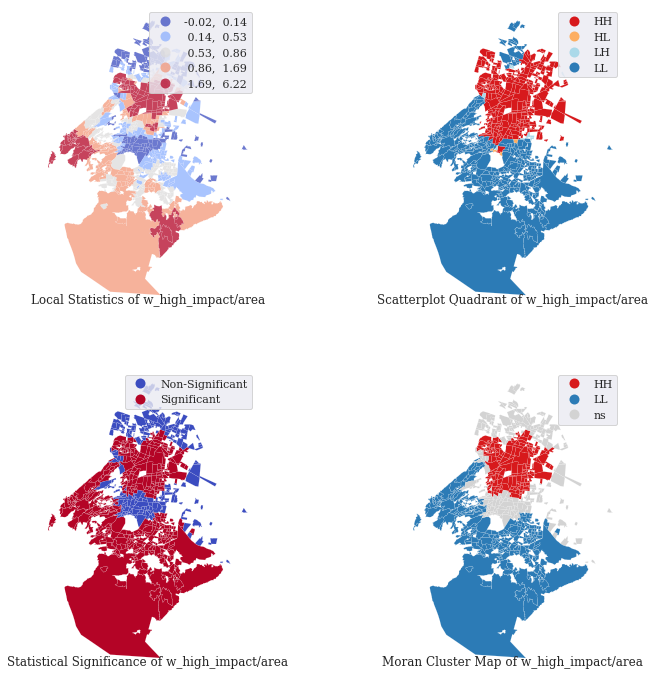

Variable:  w_low_impact/area


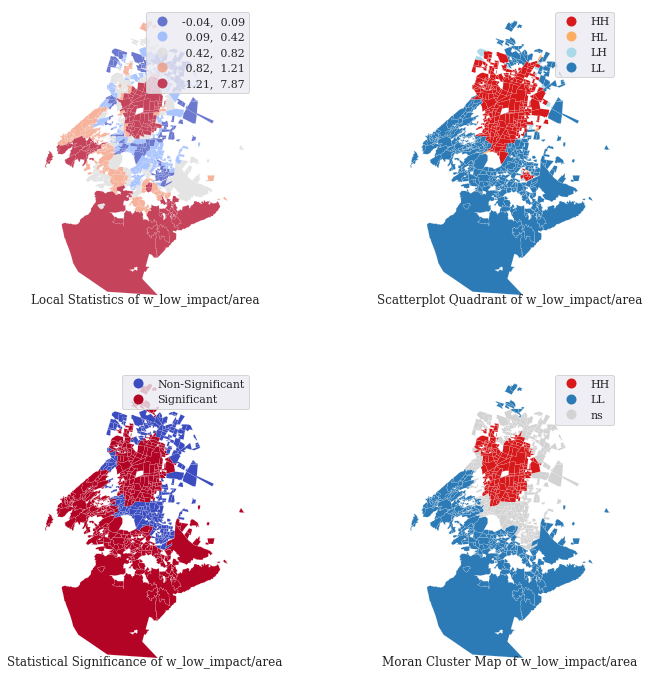

Variable:  w_parks


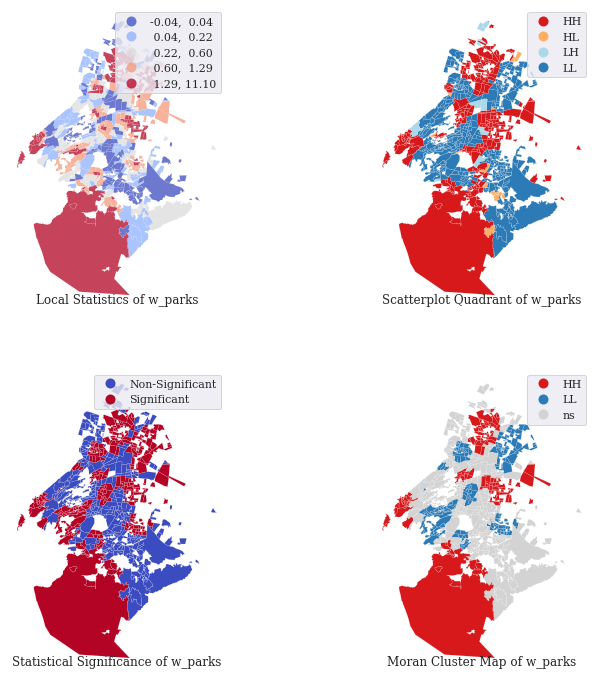

Variable:  w_schools


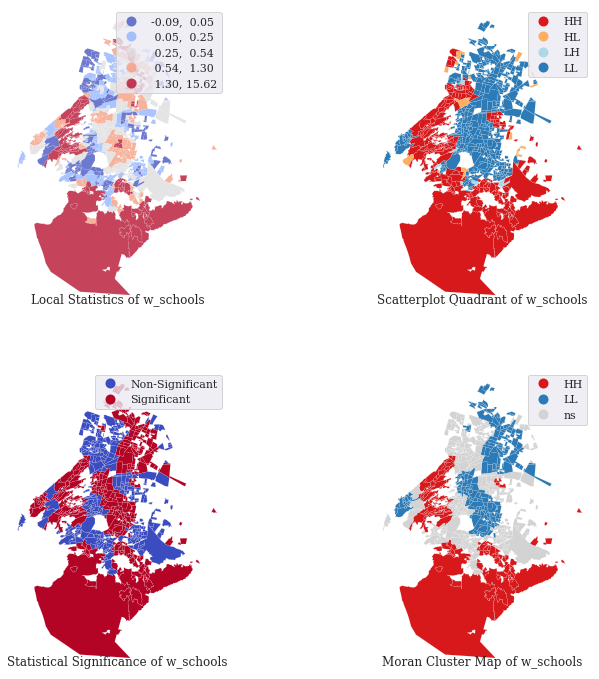

Variable:  w_university


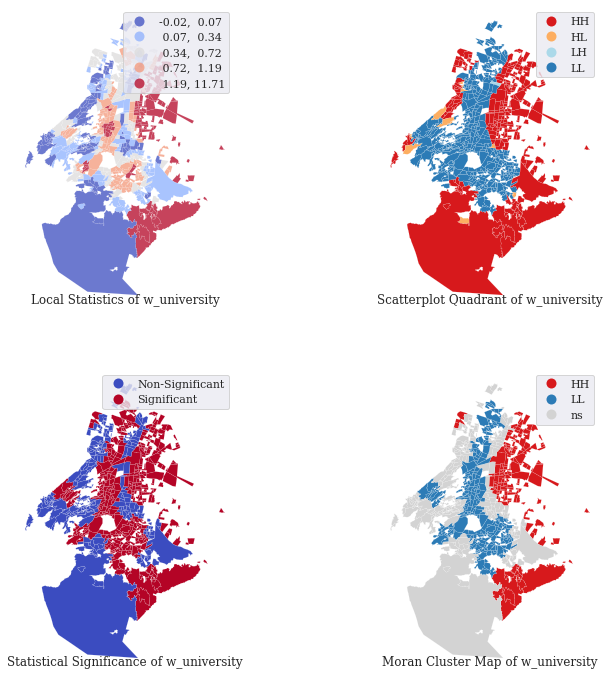

Variable:  w_hospital


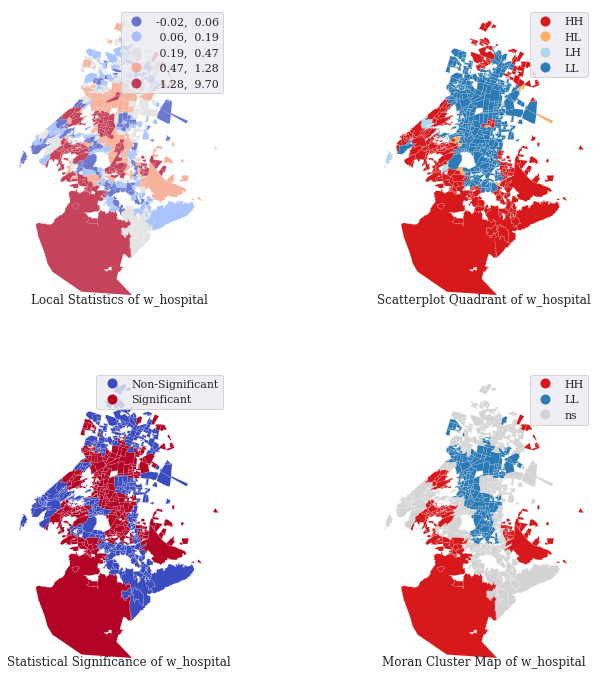

Variable:  w_sport_facility


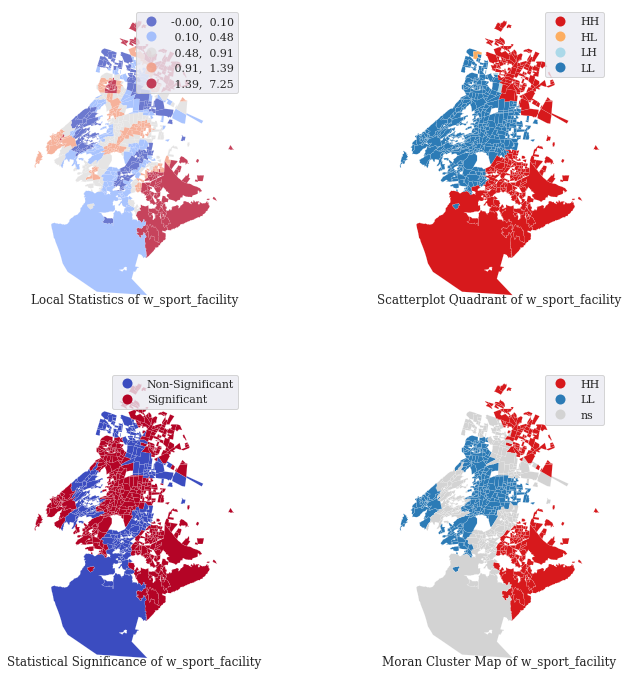

Variable:  w_supermarket


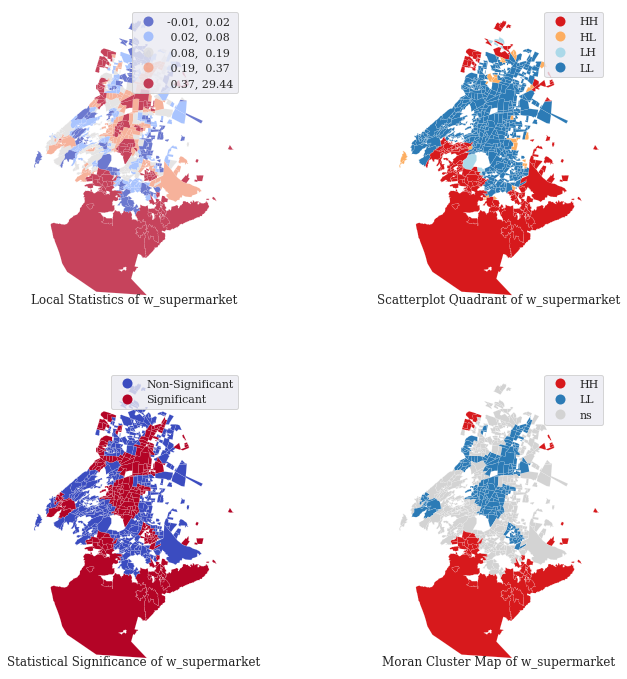

Variable:  w_mall


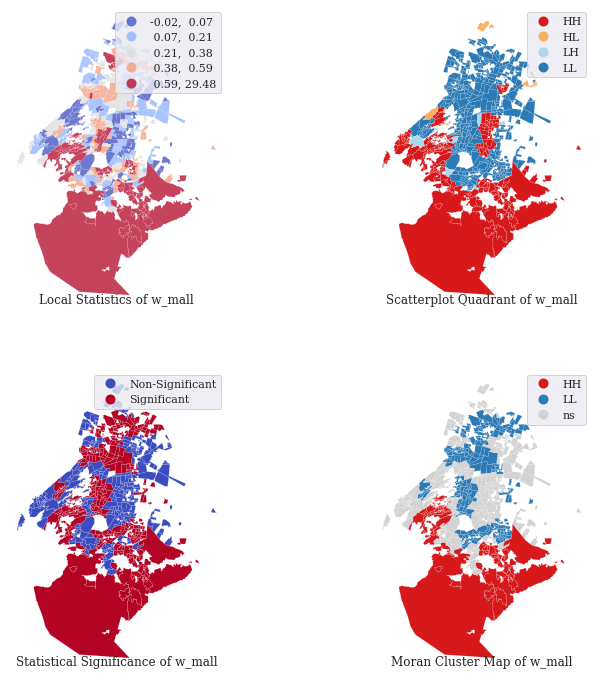

Variable:  w_stadium


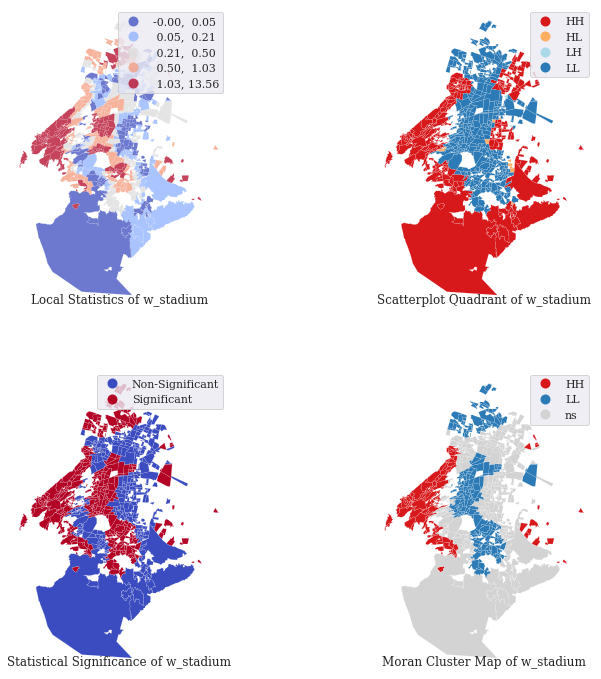

Variable:  w_historic


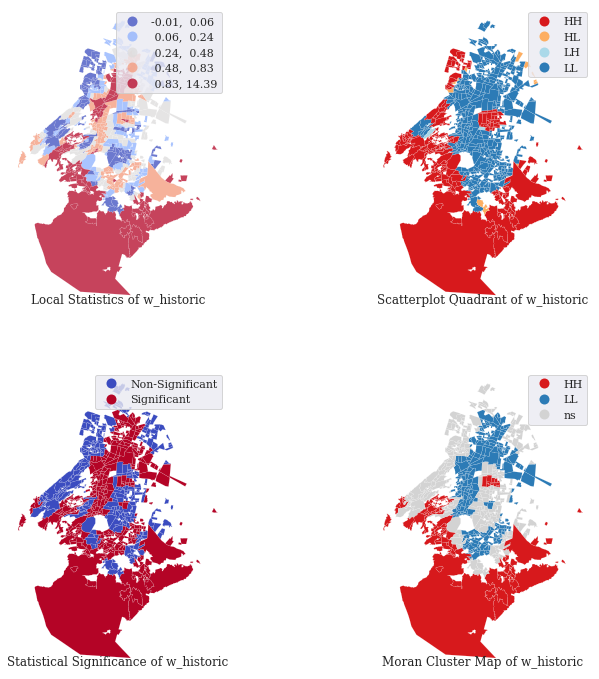

Variable:  w_museum


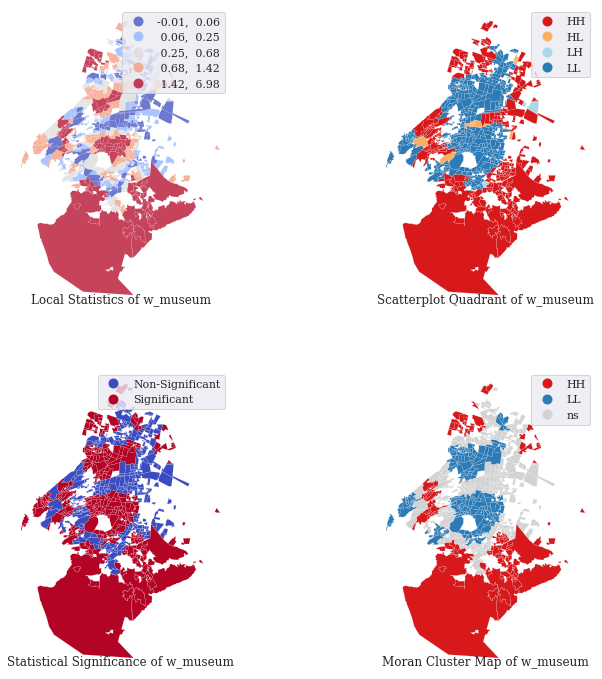

Variable:  w_airport


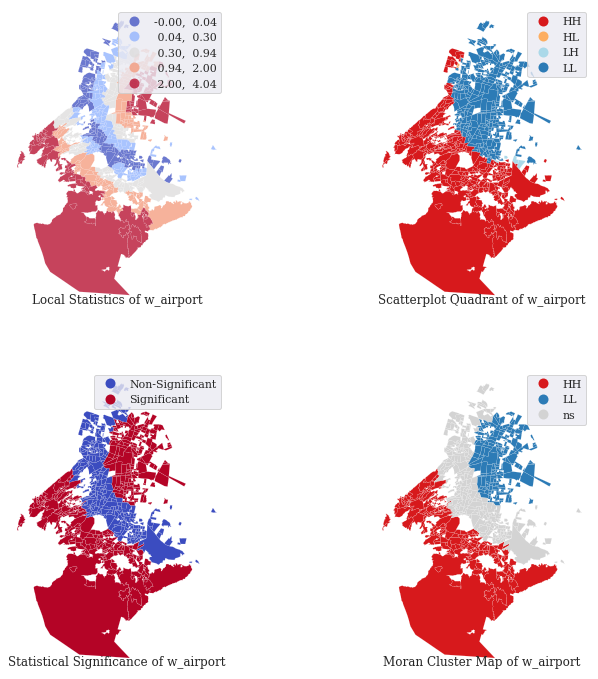

Variable:  w_industry


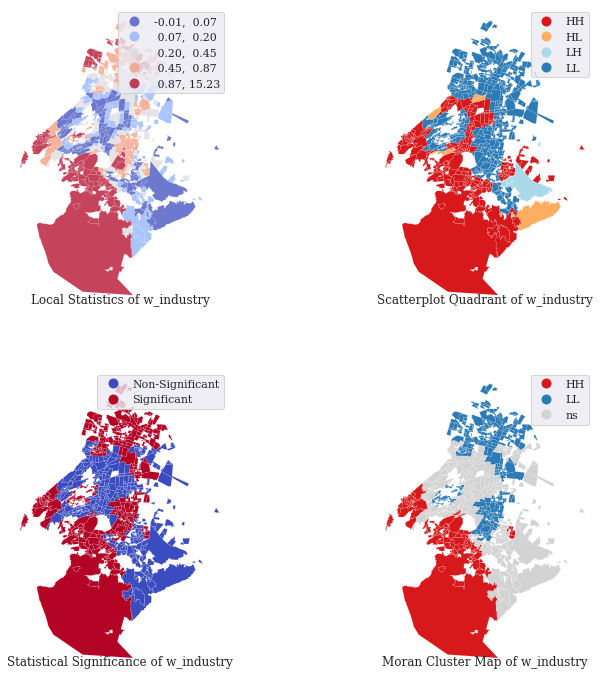

Variable:  w_subway


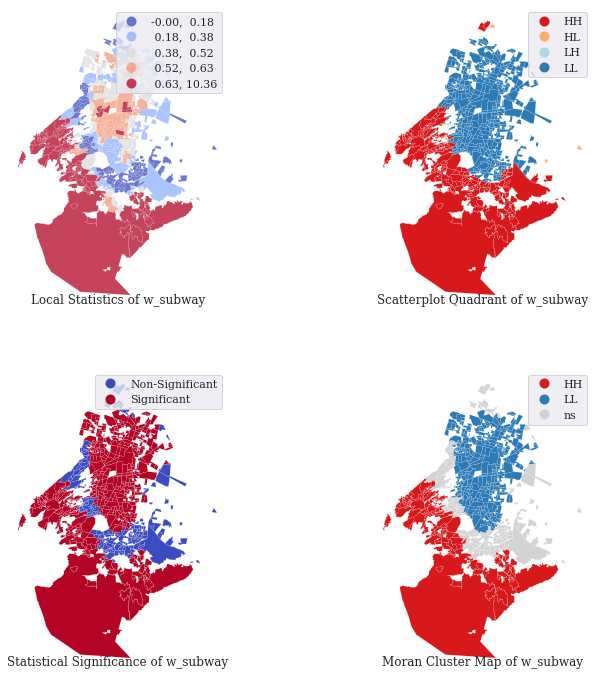

Variable:  w_bus


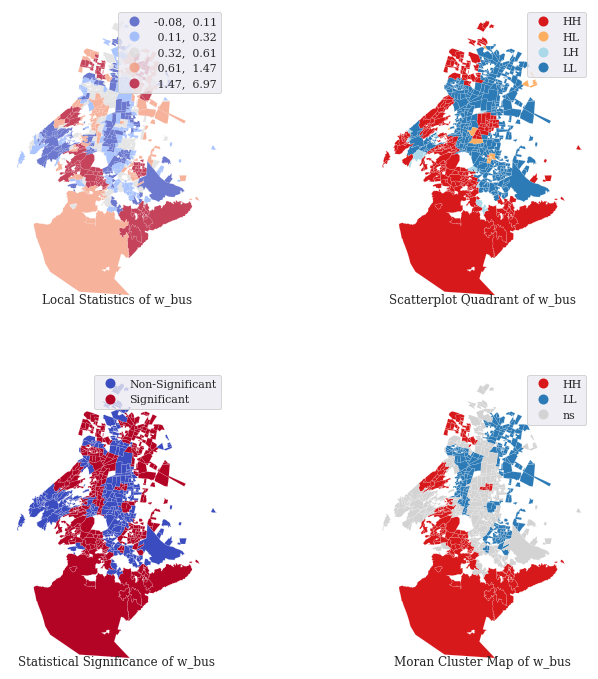

In [227]:
from splot import esda as esdaplot
#Calculating spatial lag of variables of interest
ban = ["geometry", "centroids", "id_right"]
cols = [col for col in X_df_loc.columns if col not in ban ]

for var in cols:
    X_df_loc["w_"+ var] = weights.lag_spatial(w, (X_df_loc[var]))

for var in cols:  
    try:
        print("Variable: ", var)
        #Local Moran’s 
        lisa = esda.moran.Moran_Local(X_df_loc["w_"+var], w)

        #plot
        # Set up figure and axes
        f, axs = plt.subplots(nrows=2, ncols=2, figsize=(12, 12))


        # Make the axes accessible with single indexing
        axs = axs.flatten()

        # Subplot 1 #
        # Choropleth of local statistics
        # Grab first axis in the figure
        ax = axs[0]

        # Assign new column with local statistics on-the-fly
        X_df_loc.assign(
            Is=lisa.Is
            # Plot choropleth of local statistics
        ).plot(
            column="Is",
            cmap="coolwarm",
            scheme="quantiles",
            k=5,
            edgecolor="white",
            linewidth=0.1,
            alpha=0.75,
            legend=True,
            ax=ax,
        )

        # Subplot 2 #
        # Quadrant categories
        # Grab second axis of local statistics
        ax = axs[1]
        # Plot Quadrant colors (note to ensure all polygons are assigned a
        # quadrant, we "trick" the function by setting significance level to
        # 1 so all observations are treated as "significant" and thus assigned
        # a quadrant color
        esdaplot.lisa_cluster(lisa, X_df_loc, p=1, ax=ax)

        # Subplot 3 #
        # Significance map
        # Grab third axis of local statistics
        ax = axs[2]
        #
        # Find out significant observations
        labels = pd.Series(
            1 * (lisa.p_sim < 0.05),  # Assign 1 if significant, 0 otherwise
            index=X_df_loc.index  # Use the index in the original data
            # Recode 1 to "Significant and 0 to "Non-significant"
        ).map({1: "Significant", 0: "Non-Significant"})
        # Assign labels to `db` on the fly
        X_df_loc.assign(
            cl=labels
            # Plot choropleth of (non-)significant areas
        ).plot(
            column="cl",
            categorical=True,
            k=2,
            cmap="coolwarm",
            linewidth=0.1,
            edgecolor="white",
            legend=True,
            ax=ax,
        )


        # Subplot 4 #
        # Cluster map
        # Grab second axis of local statistics
        ax = axs[3]
        # Plot Quadrant colors In this case, we use a 5% significance
        # level to select polygons as part of statistically significant
        # clusters
        esdaplot.lisa_cluster(lisa, X_df_loc, p=0.05, ax=ax)

        # Figure styling #
        # Set title to each subplot
        for i, ax in enumerate(axs.flatten()):
            ax.set_axis_off()
            ax.set_title(
                [
                    "Local Statistics of " + var,
                    "Scatterplot Quadrant of " + var,
                    "Statistical Significance of "+ var,
                    "Moran Cluster Map of "+ var,
                ][i],
                y=0,
            )
        # Tight layout to minimize in-between white space


        # Display the figure
        plt.show()
    except: 
        print("Corrupt variable")
        
        


## Estimate GWR model
### Select GWR bandwith

In [174]:
%%time
gwr_selector = Sel_BW(coords, y, X, kernel="gaussian")
gwr_bw = gwr_selector.search(criterion='AIC')

CPU times: user 23.3 s, sys: 601 ms, total: 23.9 s
Wall time: 6.58 s


In [175]:
print('GWR bandwidth =', gwr_bw)

GWR bandwidth = 115.0


# Fit GWR model

In [176]:
gwr_results = GWR(coords, y, X, gwr_bw, kernel='gaussian').fit()
gwr_results.summary()

Model type                                                         Gaussian
Number of observations:                                                 699
Number of covariates:                                                    37

Global Regression Results
---------------------------------------------------------------------------
Residual sum of squares:                                           4451.154
Log-likelihood:                                                   -1638.856
AIC:                                                               3351.712
AICc:                                                              3358.203
BIC:                                                                115.285
R2:                                                                   0.605
Adj. R2:                                                              0.583

Variable                              Est.         SE  t(Est/SE)    p-value
------------------------------- ---------- ---------- ------

In [177]:
# As reference, here is the (average) R2, AIC, and AICc
print('Mean R2 =', gwr_results.R2)
print('AIC =', gwr_results.aic)
print('AICc =', gwr_results.aicc)

Mean R2 = 0.732583390492922
AIC = 3219.483330300514
AICc = 3259.113147749645


In [178]:
#Copy to preserve original gdf
gdf_r = gdf.copy()
# Add R2 to GeoDataframe 
gdf_r['gwr_R2'] = gwr_results.localR2

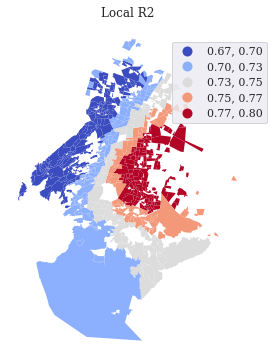

In [179]:
fig, ax = plt.subplots(figsize=(6, 6))
gdf_r.plot(column='gwr_R2', cmap = 'coolwarm', linewidth=0.01, scheme = 'FisherJenks', k=5, legend=True, legend_kwds={'bbox_to_anchor':(1.10, 0.96)},  ax=ax)
ax.set_title('Local R2', fontsize=12)
ax.axis("off")
gdf_r.explore()
plt.show()

# Plot Residuals

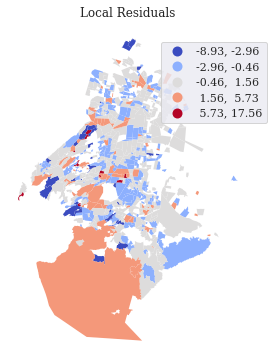

In [180]:
gdf_r['res'] = gwr_results.resid_response
fig, ax = plt.subplots(figsize=(6, 6))
gdf_r.plot(column='res', cmap = 'coolwarm', linewidth=0.01, scheme = 'FisherJenks', k=5, legend=True, legend_kwds={'bbox_to_anchor':(1.10, 0.96)},  ax=ax)
ax.set_title('Local Residuals', fontsize=12)
ax.axis("off")
gdf_r.explore()
#plt.savefig('myMap.png',dpi=150, bbox_inches='tight')
plt.show()

<AxesSubplot: xlabel='res', ylabel='Count'>

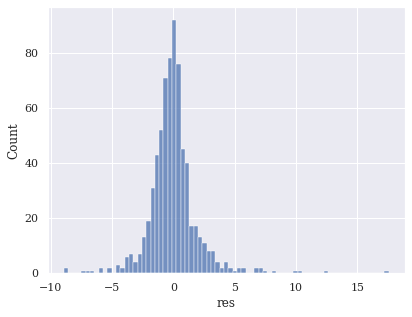

In [181]:
#plot distribution
import seaborn as sns
sns.histplot(data=gdf_r, x="res")

# Plot coefficients GLOBAL

In [182]:
#Store coef column names

coef_names = []
for num,column in enumerate (X_df.columns):


    gdf_r['gwr_{}'.format(column)] = gwr_results.params[:,num+1]
    
    coef_names.append('gwr_{}'.format(column))
gdf_r.head()

,bedrooms,bathrooms,half_bathrooms,lot_size,construction_size,age,is_house,real_age,latitude,longitude,balcony,water strorage,air_conditioning,pool,furniture,accasible_for_handicap,first_floor,security,parking_space,kitchen,garden,roof_Garden,service_room,gated_community,price_per_area,price_per_area_small,high_impact/area,low_impact/area,parks,schools,university,hospital,sport_facility,supermarket,mall,stadium,historic,museum,airport,industry,subway,bus,id_right,price,price_small,geometry,centroids,gwr_R2,res,gwr_bedrooms,gwr_bathrooms,gwr_half_bathrooms,gwr_lot_size,gwr_is_house,gwr_real_age,gwr_balcony,gwr_water strorage,gwr_air_conditioning,gwr_pool,gwr_furniture,gwr_accasible_for_handicap,gwr_first_floor,gwr_security,gwr_parking_space,gwr_kitchen,gwr_garden,gwr_roof_Garden,gwr_service_room,gwr_gated_community,gwr_high_impact/area,gwr_low_impact/area,gwr_parks,gwr_schools,gwr_university,gwr_hospital,gwr_sport_facility,gwr_supermarket,gwr_mall,gwr_stadium,gwr_historic,gwr_museum,gwr_airport,gwr_industry,gwr_subway,gwr_bus
0,1.607506,3.795655,-0.782058,-0.090367,0.101543,0.274983,1.189032,2.965947,1.189645,-0.527365,-0.280675,-0.319698,-0.078457,-0.178423,-0.060755,-0.124474,-0.037796,-0.292728,-0.30405,1.583125,-0.256962,-0.37789,-0.483958,-0.041937,-0.686690,-0.686690,-0.362235,-0.490653,-1.204725,-0.026416,-0.190933,0.217603,-0.937668,-0.393369,-0.428634,0.059922,-0.030999,0.142419,-0.086261,-0.280822,-0.360175,-0.457558,8,3400000.0,3.4000,"MULTIPOLYGON (((2793299.849 832180.730, 279330...",POINT (2793471.544 832294.395),0.687348,-4.647510,-3.466279,7.591192,10.926504,32.638213,3.970206,-2.313301,1.985543,0.314177,4.618202,0.085514,-0.420987,1.915057,0.185340,-0.192532,0.625514,0.912312,0.156981,0.375939,0.645254,0.534043,-4.512988,3.245974,-0.537155,1.070957,2.814521,1.217922,-0.489518,-2.423590,-4.948959,0.496560,-3.899463,-4.150380,6.365939,7.048493,-5.351782,-0.055947
1,-0.789660,-1.259302,-0.782058,-0.164097,-0.170815,-0.151405,-0.912587,0.167806,0.928072,-0.362927,-0.280675,-0.319698,-0.078457,-0.178423,-0.060755,-0.124474,-0.037796,-0.292728,-0.30405,1.583125,-0.256962,-0.37789,-0.483958,-0.041937,0.468556,0.468556,1.776640,1.564577,-1.733903,0.478983,-0.620477,0.066453,-1.146581,-0.490887,-0.834471,0.076028,-0.273689,-0.313227,-0.352554,-0.992470,-0.777304,-0.857703,16,2539500.0,2.5395,"MULTIPOLYGON (((2794357.004 830240.705, 279438...",POINT (2794483.270 830330.304),0.690056,-0.475401,-3.389462,7.662344,11.874993,32.484372,4.531533,-2.420625,1.969117,0.356181,4.723062,-0.073963,-0.220741,1.487627,0.321187,-0.340734,0.655488,0.965648,0.404535,0.248710,0.666898,1.081344,-4.220376,2.821909,-0.738791,1.191683,2.434812,0.966404,-0.674097,-2.864939,-4.336693,0.455353,-3.892113,-3.958200,6.167527,7.019150,-4.956193,-0.609605
2,-1.588716,-1.259302,-0.782058,-0.141148,-0.147499,-0.342970,-0.912587,-1.089330,0.628836,-0.654206,-0.280675,-0.319698,-0.078457,-0.178423,-0.060755,-0.124474,-0.037796,-0.292728,-0.30405,-1.299618,-0.256962,-0.37789,-0.483958,-0.041937,2.725285,2.725285,0.106282,1.299354,0.423617,2.150015,-0.493853,-1.058884,-0.739339,-0.711208,-0.331797,0.405543,-0.918067,-0.833031,-0.101611,0.366546,-0.586630,0.407494,33,6950000.0,6.9500,"MULTIPOLYGON (((2792835.890 828193.326, 279284...",POINT (2792847.230 827937.598),0.688815,1.068863,-4.692179,8.610435,14.160388,26.848484,6.035374,-2.469671,2.241921,0.156148,4.283251,-0.225847,0.282789,1.515921,1.766349,0.274273,0.479384,1.116042,0.081439,0.424891,0.918453,-0.563360,-3.995299,1.627192,-1.174085,2.116030,0.204304,0.616913,-0.535716,-4.987554,-5.814604,1.534451,-2.947654,-3.122525,5.011318,6.516866,-6.465580,-0.442079
3,5.602784,1.773672,-0.782058,-0.071812,0.169013,-0.342970,1.189032,-1.089330,0.492163,0.801185,-0.280675,-0.319698,-0.078457,-0.178423,-0.060755,-0.124474,-0.037796,-0.292728,-0.30405,1.583125,-0.256962,-0.37789,-0.483958,-0.041937,0.409655,0.409655,-0.181528,0.331494,-0.788814,-0.642095,1.123594,0.069091,-0.167126,-0.450806,-0.580005,-0.407965,

In [192]:
#creating copy()
gdf_abs =gdf_r.copy()
gdf_abs

#acum per coeficient
mean_coef= []
#getting abs of each var
for num,column in enumerate ('gwr_'+X_df.columns):
    gdf_abs[column] = gdf_abs[column].apply(lambda x : abs(x))
    mean_coef.append(gdf_abs[column].mean())
gdf_abs

df = pd.DataFrame(mean_coef).T
df.columns= X_df.columns
df = df.T.reset_index().rename(columns={'index': 'variable', 0: "coef_abs_value"})
df_coefs = df.sort_values(by= "coef_abs_value" )
df_coefs.tail(20)

,variable,coef_abs_value
21,low_impact/area,2.114240
29,stadium,2.237494
32,airport,2.405018
24,university,2.411851
12,first_floor,2.690040
19,gated_community,2.808483
28,mall,2.915253
31,museum,3.191003
27,supermarket,3.547586
20,high_impact/area,3.695992


<BarContainer object of 16 artists>

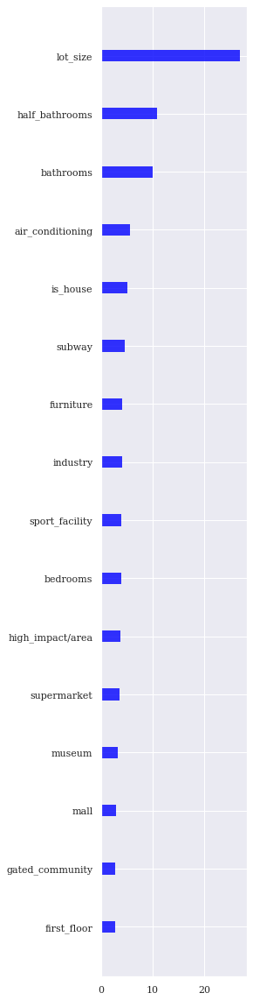

In [221]:
plt.figure(figsize=(3, 20))
plt.barh(df_coefs["variable"][20:], df_coefs["coef_abs_value"][20:], height=0.2, color='blue', alpha=0.8, align='center', linewidth=0)

# Plot coefficients LOCAL

In [185]:
# Filter t-values: standard alpha = 0.05
gwr_filtered_t = gwr_results.filter_tvals(alpha = 0.05)
# Filter t-values: corrected alpha due to multiple testing
gwr_filtered_tc = gwr_results.filter_tvals()

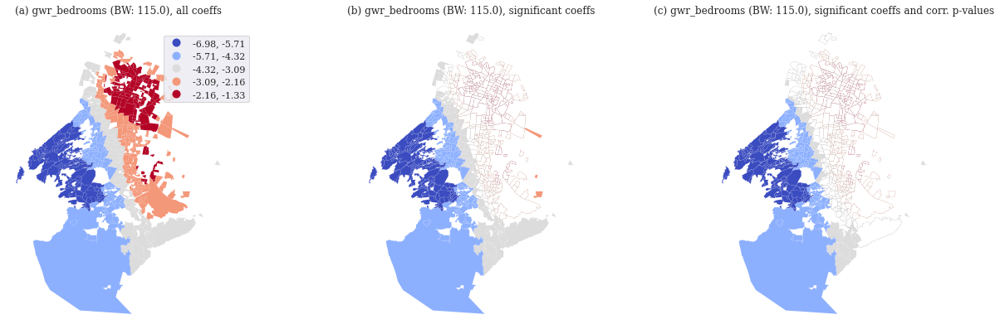

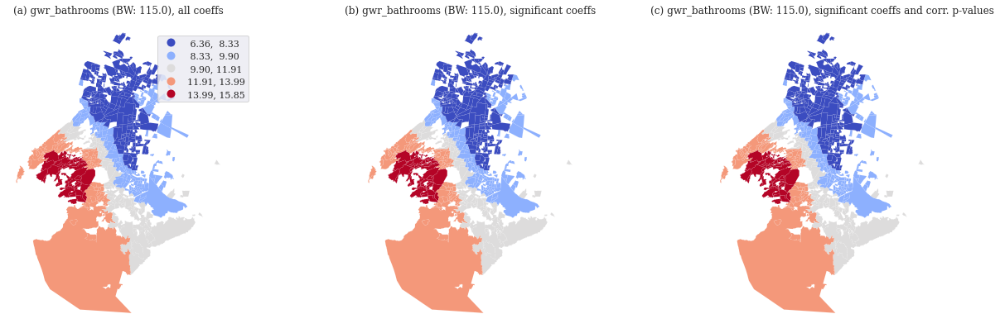

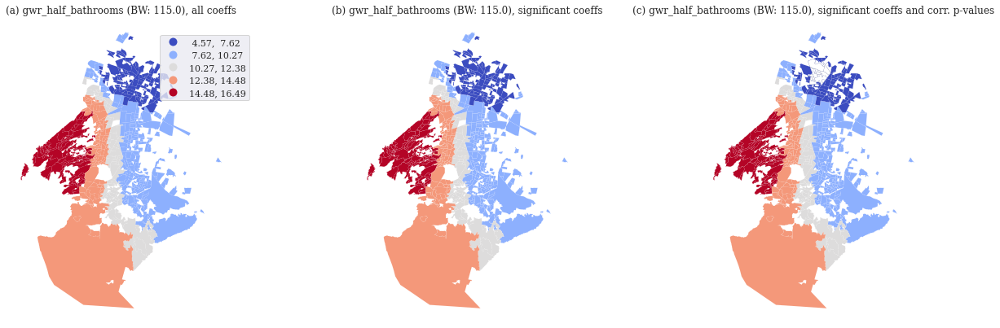

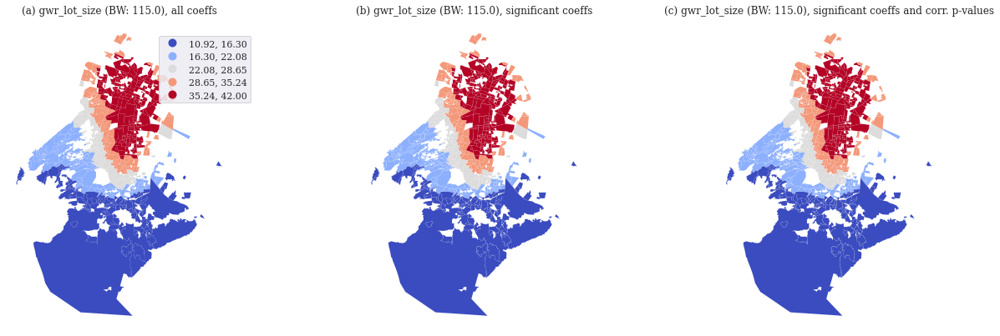

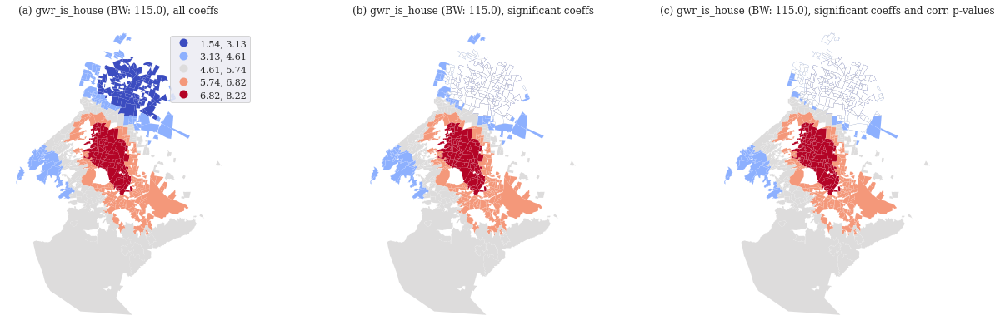

...

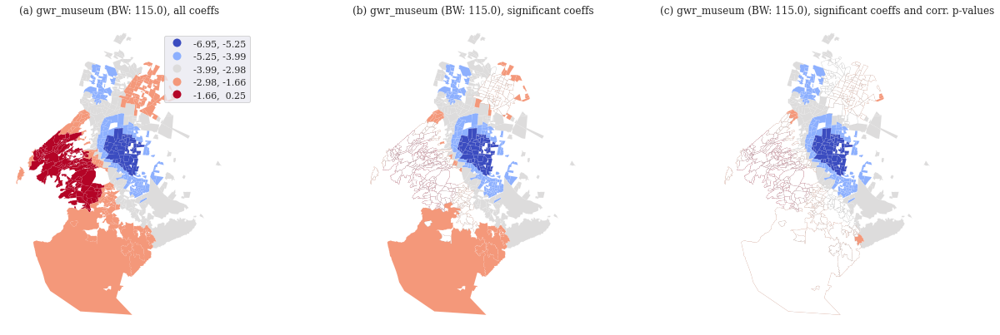

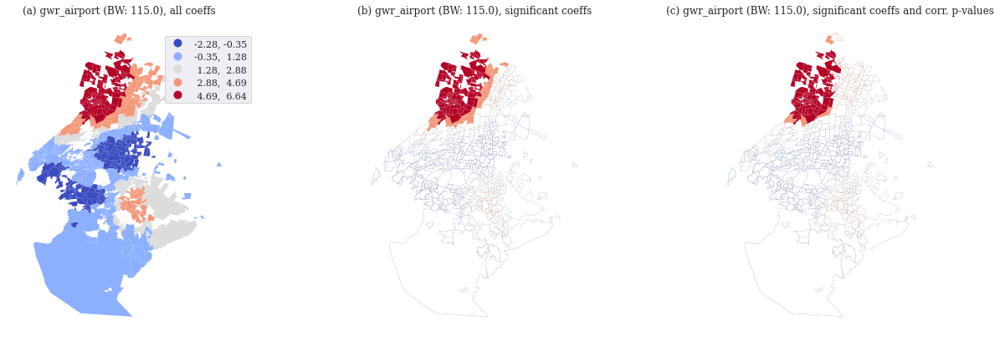

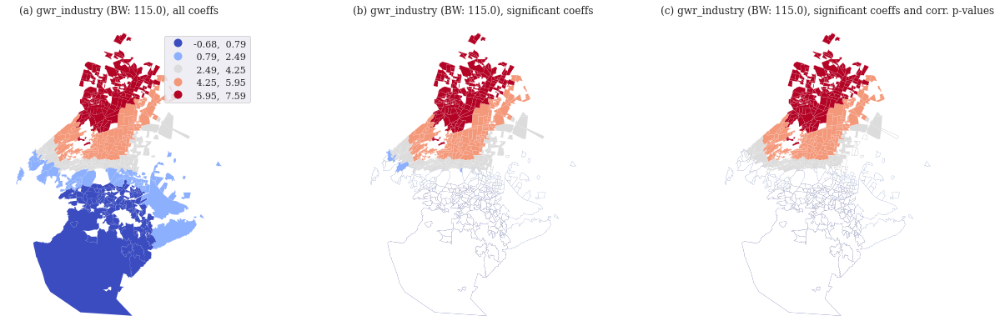

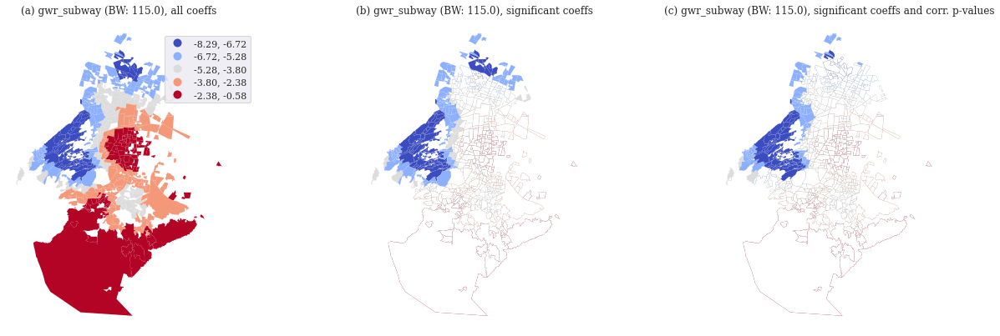

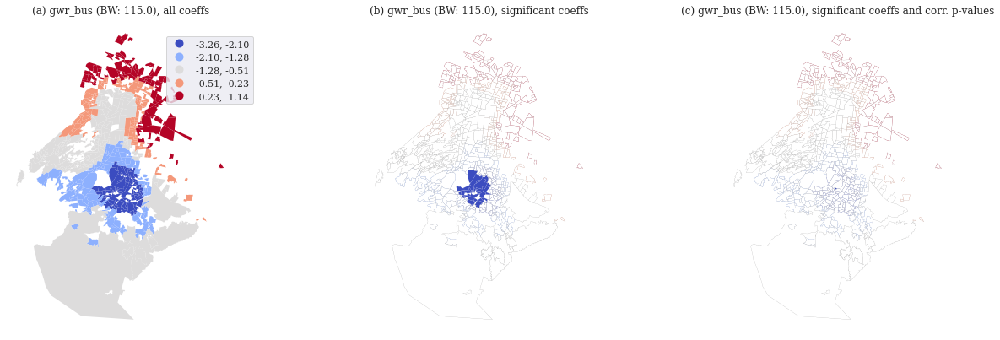

In [186]:
for num,col in enumerate (coef_names):
    fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(18,6))

    gdf_r.plot(column= col, cmap = 'coolwarm', linewidth=0.01, scheme = 'FisherJenks', k=5, legend=True, legend_kwds={'bbox_to_anchor':(1.10, 0.96)},  ax=axes[0])

    gdf_r.plot(column= col, cmap = 'coolwarm', linewidth=0.05, scheme = 'FisherJenks', k=5, legend=False, legend_kwds={'bbox_to_anchor':(1.10, 0.96)},  ax=axes[1])
    gdf_r[gwr_filtered_t[:,num+1] == 0].plot(color='white', linewidth=0.05, edgecolor='black', ax=axes[1])


    gdf_r.plot(column= col, cmap = 'coolwarm', linewidth=0.05, scheme = 'FisherJenks', k=5, legend=False, legend_kwds={'bbox_to_anchor':(1.10, 0.96)},  ax=axes[2])
    gdf_r[gwr_filtered_tc[:,num+1] == 0].plot(color='white', linewidth=0.05, edgecolor='black', ax=axes[2])

    plt.tight_layout()

    axes[0].axis("off")
    axes[1].axis("off")
    axes[2].axis("off")

    axes[0].set_title('(a) '+ col +' (BW: ' + str(gwr_bw) +'), all coeffs', fontsize=12)
    axes[1].set_title('(b) '+ col+' (BW: ' + str(gwr_bw) +'), significant coeffs',     fontsize=12)
    axes[2].set_title('(c) '+col +' (BW: ' + str(gwr_bw) +'), significant coeffs and corr. p-values',     fontsize=12)
    plt.show()

# Test spatial stationarity or non stationarity( heteroginity)?

Spatial stationarity refers to the property of a random process or phenomenon where the statistical properties, such as mean, variance, and correlation, remain constant or invariant over space. In other words, the behavior of the process or phenomenon is the same at any location within the study area.

In [187]:
# Monte Carlo test of spatial variability: 500 iterations 
gwr_p_values_stationarity = gwr_results.spatial_variability(gwr_selector, 5)#This number should be more than 100 for the final run

In [188]:
df = pd.DataFrame(gwr_p_values_stationarity[1:]).T
df.columns =  coef_names
df




,gwr_bedrooms,gwr_bathrooms,gwr_half_bathrooms,gwr_lot_size,gwr_is_house,gwr_real_age,gwr_balcony,gwr_water strorage,gwr_air_conditioning,gwr_pool,gwr_furniture,gwr_accasible_for_handicap,gwr_first_floor,gwr_security,gwr_parking_space,gwr_kitchen,gwr_garden,gwr_roof_Garden,gwr_service_room,gwr_gated_community,gwr_high_impact/area,gwr_low_impact/area,gwr_parks,gwr_schools,gwr_university,gwr_hospital,gwr_sport_facility,gwr_supermarket,gwr_mall,gwr_stadium,gwr_historic,gwr_museum,gwr_airport,gwr_industry,gwr_subway,gwr_bus
0,0.2,0.0,0.0,0.0,0.2,0.0,0.6,0.4,0.2,0.4,0.0,0.2,0.0,0.2,0.4,0.0,0.6,0.8,0.0,0.0,0.0,0.0,0.0,0.2,0.0,0.6,0.0,0.2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


IF The p-values is smaller than 0.05,the parameter estimates for this variables exhibit significant local variation

https://deepnote.com/@carlos-mendez/PYTHON-GWR-and-MGWR-71dd8ba9-a3ea-4d28-9b20-41cc8a282b7a

In [189]:
cols_variation = df.columns[(df < 0.05).any()]
print("cols with spatial variability: ",cols_variation )

cols with spatial variability:  Index(['gwr_bathrooms', 'gwr_half_bathrooms', 'gwr_lot_size', 'gwr_real_age',
       'gwr_furniture', 'gwr_first_floor', 'gwr_kitchen', 'gwr_service_room',
       'gwr_gated_community', 'gwr_high_impact/area', 'gwr_low_impact/area',
       'gwr_parks', 'gwr_university', 'gwr_sport_facility', 'gwr_mall',
       'gwr_stadium', 'gwr_historic', 'gwr_museum', 'gwr_airport',
       'gwr_industry', 'gwr_subway', 'gwr_bus'],
      dtype='object')


# Test Local multicollinearity

Local multicollinearity, also known as spatial multicollinearity, refers to the phenomenon where independent variables in a regression model are highly correlated within specific areas or regions, but not necessarily correlated at the global level.

In other words, in a spatial context, the presence of local multicollinearity means that the correlation between two or more independent variables varies across different parts of the study area. This can lead to biased and unreliable estimates of the regression coefficients, as well as inflated standard errors and reduced statistical significance.

In [190]:
LCC, VIF, CN, VDP = gwr_results.local_collinearity()
pd.DataFrame(VIF, columns= coef_names).describe().round(2)

,gwr_bedrooms,gwr_bathrooms,gwr_half_bathrooms,gwr_lot_size,gwr_is_house,gwr_real_age,gwr_balcony,gwr_water strorage,gwr_air_conditioning,gwr_pool,gwr_furniture,gwr_accasible_for_handicap,gwr_first_floor,gwr_security,gwr_parking_space,gwr_kitchen,gwr_garden,gwr_roof_Garden,gwr_service_room,gwr_gated_community,gwr_high_impact/area,gwr_low_impact/area,gwr_parks,gwr_schools,gwr_university,gwr_hospital,gwr_sport_facility,gwr_supermarket,gwr_mall,gwr_stadium,gwr_historic,gwr_museum,gwr_airport,gwr_industry,gwr_subway,gwr_bus
count,699.00,699.00,699.00,699.00,699.00,699.00,699.00,699.00,699.00,699.00,699.00,699.00,699.00,699.00,699.00,699.00,699.00,699.00,699.00,699.00,699.00,699.00,699.00,699.00,699.00,699.00,699.00,699.00,699.00,699.00,699.00,699.00,699.00,699.00,699.00,699.00
mean,2.65,2.90,1.56,1.98,2.60,1.51,1.18,1.28,1.06,1.33,1.05,1.08,1.08,4.56,1.36,2.01,4.16,1.44,1.48,1.07,3.04,3.28,1.36,1.46,4.31,1.90,2.41,2.00,3.06,3.71,2.68,2.33,9.03,2.24,11.59,1.60
std,0.44,0.27,0.10,0.26,0.26,0.12,0.05,0.09,0.03,0.15,0.04,0.01,0.14,1.64,0.12,0.17,1.56,0.20,0.20,0.09,0.63,0.49,0.17,0.14,1.36,0.22,0.56,0.72,1.65,2.54,0.68,0.43,3.38,0.81,9.22,0.23
min,2.15,2.36,1.40,1.63,2.26,1.30,1.12,1.16,1.01,1.12,1.00,1.05,1.00,2.34,1.24,1.81,2.18,1.16,1.23,1.01,2.28,2.70,1.11,1.26,2.38,1.56,1.45,1.37,1.47,1.54,1.87,1.62,4.23,1.37,2.27,1.28
25%,2.31,2.68,1.47,1.76,2.38,1.41,1.15,1.20,1.04,1.21,1.02,1.07,1.00,3.27,1.26,1.88,2.88,1.27,1.32,1.01,2.45,2.79,1.22,1.35,3.01,1.70,1.93,1.54,1.78,1.95,2.03,1.98,5.76,1.59,3.72,1.47
50%,2.52,2.92,1.56,1.89,2.53,1.52,1.17,1.27,1.06,1.30,1.04,1.08,1.02,4.11,1.30,1.96,3.64,1.39,1.41,1.02,2.98,3.19,1.33,1.42,4.23,1.90,2.39,1.72,2.20,2.70,2.50,2.32,8.94,1.80,8.24,1.56
75%,2.87,3.11,1.63,2.22,2.81,1.57,1.20,1.35,1.09,1.42,1.08,1.09,1.07,6.10,1.44,2.09,5.64,1.58,1.66,1.06,3.56,3.63,1.45,1.54,5.22,2.04,2.86,2.25,4.26,4.35,3.33,2.68,12.06,2.78,18.85,1.63
max,3.76,3.55,1.82,2.52,3.22,1.79,1.37,1.51,1.12,1.79,1.16,1.11,1.56,8.02,1.69,2.55,7.51,1.97,1.91,1.42,4.53,4.54,1.91,1.80,7.41,2.52,3.55,4.61,8.06,12.50,4.26,3.46,17.73,4.31,40.38,2.55


If VIF less than 10 for each variable, no signss of loca multicolinearity

In [191]:
#Columns with local multicolinearity
df = pd.DataFrame(VIF, columns= coef_names).describe().round(2).iloc[1]
print("Columns with local multicolinearity", df[df>10].index)

Columns with local multicolinearity Index(['gwr_subway'], dtype='object')


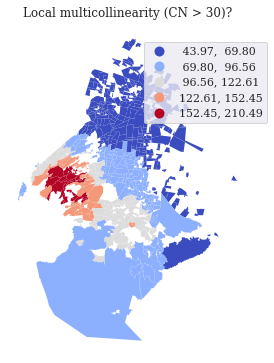

In [72]:
gdf_r['gwr_CN'] = CN

fig, ax = plt.subplots(figsize=(6, 6))
gdf_r.plot(column='gwr_CN', cmap = 'coolwarm', linewidth=0.01, scheme = 'FisherJenks', k=5, legend=True, legend_kwds={'bbox_to_anchor':(1.10, 0.96)},  ax=ax)
ax.set_title('Local multicollinearity (CN > 30)?', fontsize=12)
ax.axis("off")
#plt.savefig('myMap.png',dpi=150, bbox_inches='tight')
plt.show()

## MGWR

In [193]:
mgwr_selector = Sel_BW(coords, y, X, multi=True, kernel='gaussian')
mgwr_bw = mgwr_selector.search(criterion='AIC')
mgwr_bw

Backfitting:   0%|          | 0/200 [00:00<?, ?it/s]

array([698., 698.,  43.,  43.,  43.,  43., 696., 698., 698., 566., 698.,
       145., 698., 293., 698., 698., 378., 698., 698., 220., 698., 698.,
       206., 698., 642., 698., 698., 698., 698., 698., 698., 698.,  44.,
       698.,  56., 698., 698.])

In [194]:
mgwr_results = MGWR(coords, y, X, mgwr_selector, kernel='gaussian').fit()
mgwr_results.summary()

Inference:   0%|          | 0/1 [00:00<?, ?it/s]

Model type                                                         Gaussian
Number of observations:                                                 699
Number of covariates:                                                    37

Global Regression Results
---------------------------------------------------------------------------
Residual sum of squares:                                           4451.154
Log-likelihood:                                                   -1638.856
AIC:                                                               3351.712
AICc:                                                              3358.203
BIC:                                                                115.285
R2:                                                                   0.605
Adj. R2:                                                              0.583

Variable                              Est.         SE  t(Est/SE)    p-value
------------------------------- ---------- ---------- ------

In [195]:
# As reference, here is the (average) R2, AIC, and AICc
print('Mean R2 =', mgwr_results.R2)
print('AIC =', mgwr_results.aic)
print('AICc =', mgwr_results.aicc)

Mean R2 = 0.7433929020383614
AIC = 3115.614543441226
AICc = 3131.5105431729926


# Show bandwidth intervals

In [196]:
mgwr_bw_ci = mgwr_results.get_bws_intervals(mgwr_selector)
print(mgwr_bw_ci)

[(448.0, 698.0), (448.0, 698.0), (43.0, 47.0), (43.0, 51.0), (43.0, 47.0), (43.0, 47.0), (448.0, 696.0), (448.0, 698.0), (448.0, 698.0), (448.0, 566.0), (448.0, 698.0), (138.0, 293.0), (448.0, 698.0), (293.0, 293.0), (448.0, 698.0), (448.0, 698.0), (375.0, 448.0), (448.0, 698.0), (448.0, 698.0), (220.0, 293.0), (448.0, 698.0), (448.0, 698.0), (197.0, 293.0), (448.0, 698.0), (448.0, 642.0), (448.0, 698.0), (448.0, 698.0), (448.0, 698.0), (448.0, 698.0), (448.0, 698.0), (448.0, 698.0), (448.0, 698.0), (44.0, 101.0), (448.0, 698.0), (56.0, 101.0), (448.0, 698.0), (448.0, 698.0)]


In [197]:
#Copy to preserve original gdf
gdf_mr = gdf.copy()

# Local R2 are NOT yet implemented in MGWR
#mgwr_results.localR2[0:5]

# Plot Residuals

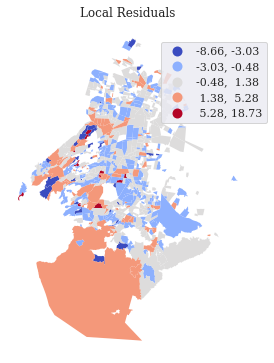

In [198]:
gdf_mr['res'] = mgwr_results.resid_response
fig, ax = plt.subplots(figsize=(6, 6))
gdf_mr.plot(column='res', cmap = 'coolwarm', linewidth=0.01, scheme = 'FisherJenks', k=5, legend=True, legend_kwds={'bbox_to_anchor':(1.10, 0.96)},  ax=ax)
ax.set_title('Local Residuals', fontsize=12)
ax.axis("off")
#plt.savefig('myMap.png',dpi=150, bbox_inches='tight')
plt.show()



<AxesSubplot: xlabel='res', ylabel='Count'>

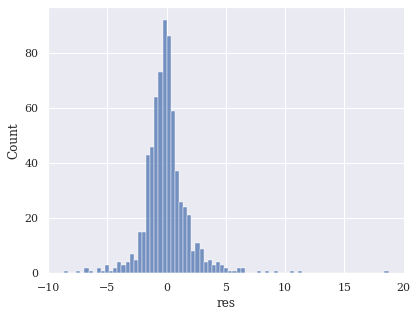

In [199]:
#plot distribution
import seaborn as sns
sns.histplot(data=gdf_mr, x="res")

# Plot coefficients GLOBAL

In [210]:
#Store coef column names

coef_names = []
for num,column in enumerate (X_df.columns):


    gdf_mr['gwr_{}'.format(column)] = mgwr_results.params[:,num+1]
    
    coef_names.append('gwr_{}'.format(column))
gdf_mr.head()

,bedrooms,bathrooms,half_bathrooms,lot_size,construction_size,age,is_house,real_age,latitude,longitude,balcony,water strorage,air_conditioning,pool,furniture,accasible_for_handicap,first_floor,security,parking_space,kitchen,garden,roof_Garden,service_room,gated_community,price_per_area,price_per_area_small,high_impact/area,low_impact/area,parks,schools,university,hospital,sport_facility,supermarket,mall,stadium,historic,museum,airport,industry,subway,bus,id_right,price,price_small,geometry,centroids,res,gwr_bedrooms,gwr_bathrooms,gwr_half_bathrooms,gwr_lot_size,gwr_is_house,gwr_real_age,gwr_balcony,gwr_water strorage,gwr_air_conditioning,gwr_pool,gwr_furniture,gwr_accasible_for_handicap,gwr_first_floor,gwr_security,gwr_parking_space,gwr_kitchen,gwr_garden,gwr_roof_Garden,gwr_service_room,gwr_gated_community,gwr_high_impact/area,gwr_low_impact/area,gwr_parks,gwr_schools,gwr_university,gwr_hospital,gwr_sport_facility,gwr_supermarket,gwr_mall,gwr_stadium,gwr_historic,gwr_museum,gwr_airport,gwr_industry,gwr_subway,gwr_bus,mgwr_CN
0,1.607506,3.795655,-0.782058,-0.090367,0.101543,0.274983,1.189032,2.965947,1.189645,-0.527365,-0.280675,-0.319698,-0.078457,-0.178423,-0.060755,-0.124474,-0.037796,-0.292728,-0.30405,1.583125,-0.256962,-0.37789,-0.483958,-0.041937,-0.686690,-0.686690,-0.362235,-0.490653,-1.204725,-0.026416,-0.190933,0.217603,-0.937668,-0.393369,-0.428634,0.059922,-0.030999,0.142419,-0.086261,-0.280822,-0.360175,-0.457558,8,3400000.0,3.4000,"MULTIPOLYGON (((2793299.849 832180.730, 279330...",POINT (2793471.544 832294.395),-4.093855,-3.820705,8.209239,21.765846,33.740222,-1.532007,-0.789502,0.355744,-0.216109,2.636711,0.118416,-0.257722,-0.160736,2.108294,0.041690,-0.286736,0.016856,-0.108750,0.795252,-0.078957,-0.412212,-3.558356,1.180592,-1.110475,1.047795,-0.207029,0.030967,-0.337496,-0.376696,-2.526685,-0.912032,-0.667024,-2.730806,2.123385,7.502621,-2.541529,-1.166609,46.206861
1,-0.789660,-1.259302,-0.782058,-0.164097,-0.170815,-0.151405,-0.912587,0.167806,0.928072,-0.362927,-0.280675,-0.319698,-0.078457,-0.178423,-0.060755,-0.124474,-0.037796,-0.292728,-0.30405,1.583125,-0.256962,-0.37789,-0.483958,-0.041937,0.468556,0.468556,1.776640,1.564577,-1.733903,0.478983,-0.620477,0.066453,-1.146581,-0.490887,-0.834471,0.076028,-0.273689,-0.313227,-0.352554,-0.992470,-0.777304,-0.857703,16,2539500.0,2.5395,"MULTIPOLYGON (((2794357.004 830240.705, 279438...",POINT (2794483.270 830330.304),0.174632,-3.819556,10.159057,26.360601,31.467555,-0.067571,-0.788091,0.351431,-0.216012,2.676330,0.116205,-0.251113,-0.165538,2.108294,0.042452,-0.288776,0.024435,-0.106341,0.795833,-0.054597,-0.411771,-3.559843,1.170225,-1.112670,1.055573,-0.208364,0.028083,-0.338003,-0.384538,-2.527654,-0.913828,-0.668924,-2.778364,2.122766,7.728018,-2.543066,-1.169085,44.469092
2,-1.588716,-1.259302,-0.782058,-0.141148,-0.147499,-0.342970,-0.912587,-1.089330,0.628836,-0.654206,-0.280675,-0.319698,-0.078457,-0.178423,-0.060755,-0.124474,-0.037796,-0.292728,-0.30405,-1.299618,-0.256962,-0.37789,-0.483958,-0.041937,2.725285,2.725285,0.106282,1.299354,0.423617,2.150015,-0.493853,-1.058884,-0.739339,-0.711208,-0.331797,0.405543,-0.918067,-0.833031,-0.101611,0.366546,-0.586630,0.407494,33,6950000.0,6.9500,"MULTIPOLYGON (((2792835.890 828193.326, 279284...",POINT (2792847.230 827937.598),1.837461,-3.817511,10.625324,19.025260,22.997655,3.811676,-0.785415,0.344069,-0.215238,2.673781,0.119439,0.040957,-0.168290,2.108294,0.049244,-0.296095,0.041541,-0.099402,0.795505,-0.131794,-0.415535,-3.565749,1.063377,-1.116621,1.080070,-0.206712,0.026585,-0.336468,-0.380716,-2.531256,-0.911282,-0.667586,-1.142486,2.122353,7.849862,-2.542798,-1.178754,44.997636
3,5.602784,1.773672,-0.782058,-0.071812,0.169013,-0.342970,1.189032,-1.089330,0.492163,0.801185,-0.280675,-0.319698,-0.078457,-0.178423,-0.060755,-0.124474,-0.037796,-0.292728,-0.30405,1.583125,-0.256962,-0.37789,-0.483958,-0.041937,0.409655,0.409655,-0.181528,0.331494,-0.788814,-0.642095,1.123594,0.069091,-0.167126,-0.4

In [211]:
#creating copy()
gdf_abs_m =gdf_mr.copy()
gdf_abs_m

#acum per coeficient
mean_coef= []
#getting abs of each var
for num,column in enumerate ('gwr_'+X_df.columns):
    gdf_abs_m[column] = gdf_abs_m[column].apply(lambda x : abs(x))
    mean_coef.append(gdf_abs_m[column].mean())
gdf_abs_m

df = pd.DataFrame(mean_coef).T
df.columns= X_df.columns
df = df.T.reset_index().rename(columns={'index': 'variable', 0: "coef_abs_value"})
df_coefs_m = df.sort_values(by= "coef_abs_value" )
df_coefs_m.tail(20)

,variable,coef_abs_value
5,real_age,0.763152
17,roof_Garden,0.816702
29,stadium,0.924263
23,schools,1.019204
22,parks,1.133134
35,bus,1.194681
10,furniture,1.577192
31,museum,1.961709
12,first_floor,2.108294
32,airport,2.118544


<BarContainer object of 16 artists>

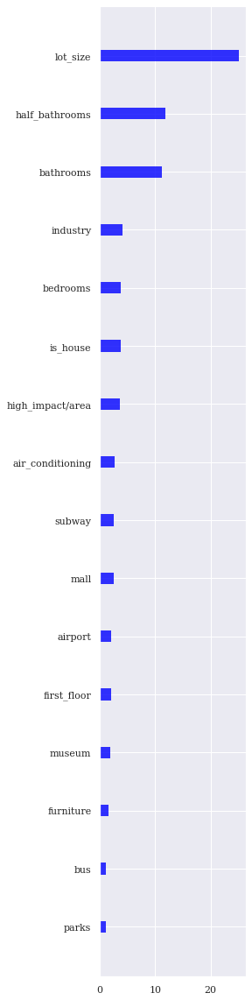

In [219]:
plt.figure(figsize=(3, 20))
plt.barh(df_coefs_m["variable"][20:], df_coefs_m["coef_abs_value"][20:], height=0.2, color='blue', alpha=0.8, align='center', linewidth=0)

# Plot coefficients Local

In [200]:
#Store coef column names
coef_names = []
for num,column in enumerate (X_df.columns):


    gdf_mr['gwr_{}'.format(column)] = mgwr_results.params[:,num+1]
    coef_names.append('gwr_{}'.format(column))
gdf_mr.head()

,bedrooms,bathrooms,half_bathrooms,lot_size,construction_size,age,is_house,real_age,latitude,longitude,balcony,water strorage,air_conditioning,pool,furniture,accasible_for_handicap,first_floor,security,parking_space,kitchen,garden,roof_Garden,service_room,gated_community,price_per_area,price_per_area_small,high_impact/area,low_impact/area,parks,schools,university,hospital,sport_facility,supermarket,mall,stadium,historic,museum,airport,industry,subway,bus,id_right,price,price_small,geometry,centroids,res,gwr_bedrooms,gwr_bathrooms,gwr_half_bathrooms,gwr_lot_size,gwr_is_house,gwr_real_age,gwr_balcony,gwr_water strorage,gwr_air_conditioning,gwr_pool,gwr_furniture,gwr_accasible_for_handicap,gwr_first_floor,gwr_security,gwr_parking_space,gwr_kitchen,gwr_garden,gwr_roof_Garden,gwr_service_room,gwr_gated_community,gwr_high_impact/area,gwr_low_impact/area,gwr_parks,gwr_schools,gwr_university,gwr_hospital,gwr_sport_facility,gwr_supermarket,gwr_mall,gwr_stadium,gwr_historic,gwr_museum,gwr_airport,gwr_industry,gwr_subway,gwr_bus
0,1.607506,3.795655,-0.782058,-0.090367,0.101543,0.274983,1.189032,2.965947,1.189645,-0.527365,-0.280675,-0.319698,-0.078457,-0.178423,-0.060755,-0.124474,-0.037796,-0.292728,-0.30405,1.583125,-0.256962,-0.37789,-0.483958,-0.041937,-0.686690,-0.686690,-0.362235,-0.490653,-1.204725,-0.026416,-0.190933,0.217603,-0.937668,-0.393369,-0.428634,0.059922,-0.030999,0.142419,-0.086261,-0.280822,-0.360175,-0.457558,8,3400000.0,3.4000,"MULTIPOLYGON (((2793299.849 832180.730, 279330...",POINT (2793471.544 832294.395),-4.093855,-3.820705,8.209239,21.765846,33.740222,-1.532007,-0.789502,0.355744,-0.216109,2.636711,0.118416,-0.257722,-0.160736,2.108294,0.041690,-0.286736,0.016856,-0.108750,0.795252,-0.078957,-0.412212,-3.558356,1.180592,-1.110475,1.047795,-0.207029,0.030967,-0.337496,-0.376696,-2.526685,-0.912032,-0.667024,-2.730806,2.123385,7.502621,-2.541529,-1.166609
1,-0.789660,-1.259302,-0.782058,-0.164097,-0.170815,-0.151405,-0.912587,0.167806,0.928072,-0.362927,-0.280675,-0.319698,-0.078457,-0.178423,-0.060755,-0.124474,-0.037796,-0.292728,-0.30405,1.583125,-0.256962,-0.37789,-0.483958,-0.041937,0.468556,0.468556,1.776640,1.564577,-1.733903,0.478983,-0.620477,0.066453,-1.146581,-0.490887,-0.834471,0.076028,-0.273689,-0.313227,-0.352554,-0.992470,-0.777304,-0.857703,16,2539500.0,2.5395,"MULTIPOLYGON (((2794357.004 830240.705, 279438...",POINT (2794483.270 830330.304),0.174632,-3.819556,10.159057,26.360601,31.467555,-0.067571,-0.788091,0.351431,-0.216012,2.676330,0.116205,-0.251113,-0.165538,2.108294,0.042452,-0.288776,0.024435,-0.106341,0.795833,-0.054597,-0.411771,-3.559843,1.170225,-1.112670,1.055573,-0.208364,0.028083,-0.338003,-0.384538,-2.527654,-0.913828,-0.668924,-2.778364,2.122766,7.728018,-2.543066,-1.169085
2,-1.588716,-1.259302,-0.782058,-0.141148,-0.147499,-0.342970,-0.912587,-1.089330,0.628836,-0.654206,-0.280675,-0.319698,-0.078457,-0.178423,-0.060755,-0.124474,-0.037796,-0.292728,-0.30405,-1.299618,-0.256962,-0.37789,-0.483958,-0.041937,2.725285,2.725285,0.106282,1.299354,0.423617,2.150015,-0.493853,-1.058884,-0.739339,-0.711208,-0.331797,0.405543,-0.918067,-0.833031,-0.101611,0.366546,-0.586630,0.407494,33,6950000.0,6.9500,"MULTIPOLYGON (((2792835.890 828193.326, 279284...",POINT (2792847.230 827937.598),1.837461,-3.817511,10.625324,19.025260,22.997655,3.811676,-0.785415,0.344069,-0.215238,2.673781,0.119439,0.040957,-0.168290,2.108294,0.049244,-0.296095,0.041541,-0.099402,0.795505,-0.131794,-0.415535,-3.565749,1.063377,-1.116621,1.080070,-0.206712,0.026585,-0.336468,-0.380716,-2.531256,-0.911282,-0.667586,-1.142486,2.122353,7.849862,-2.542798,-1.178754
3,5.602784,1.773672,-0.782058,-0.071812,0.169013,-0.342970,1.189032,-1.089330,0.492163,0.801185,-0.280675,-0.319698,-0.078457,-0.178423,-0.060755,-0.124474,-0.037796,-0.292728,-0.30405,1.583125,-0.256962,-0.37789,-0.483958,-0.041937,0.409655,0.409655,-0.181528,0.331494,-0.788814,-0.642095,1.123594,0.069091,-0.167126,-0.450806,-0.580005,-0.407965,-0.400672,-0

In [201]:
# Filter t-values: standard alpha = 0.05
mgwr_filtered_t = mgwr_results.filter_tvals(alpha = 0.05)
# Filter t-values: corrected alpha due to multiple testing
mgwr_filtered_tc = mgwr_results.filter_tvals()

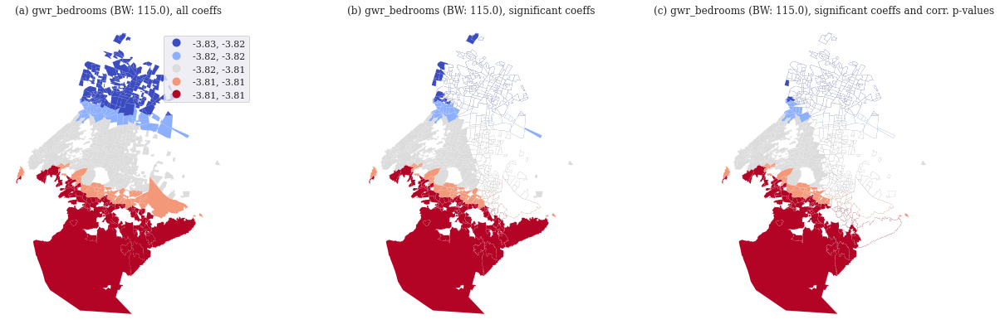

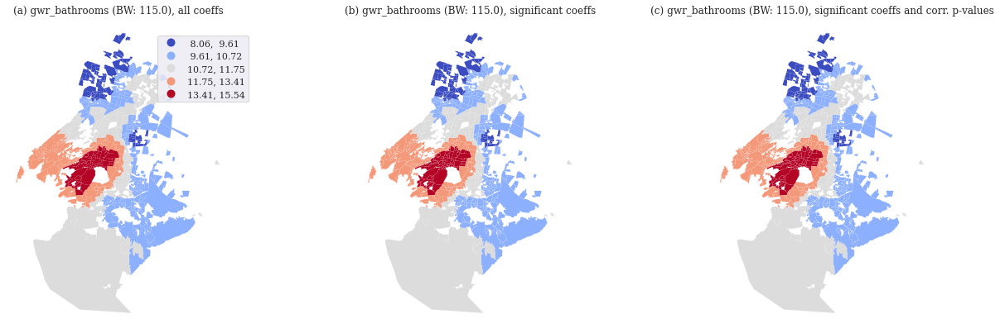

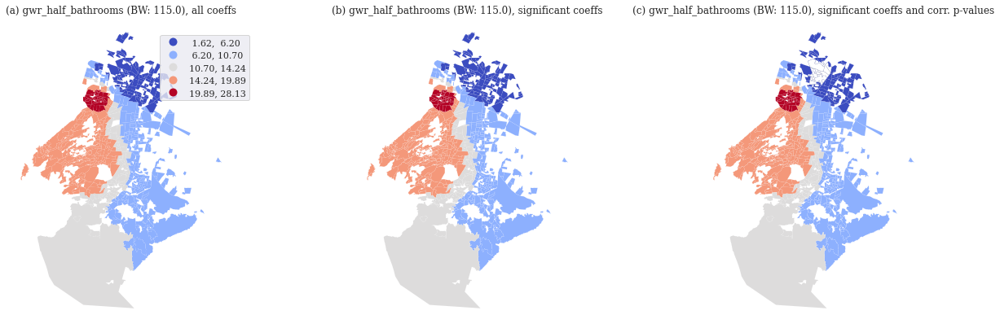

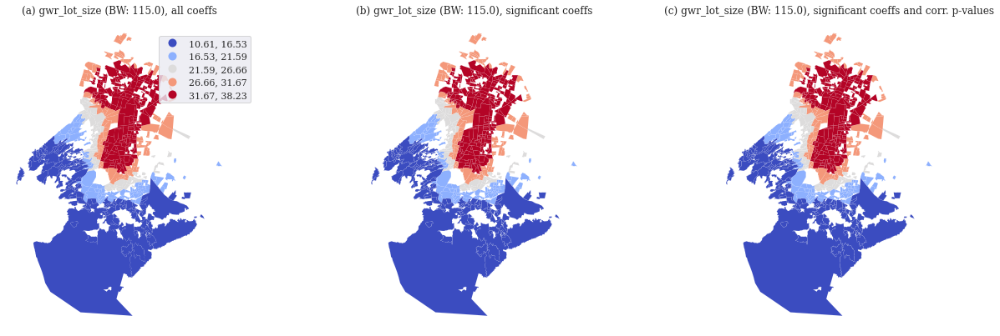

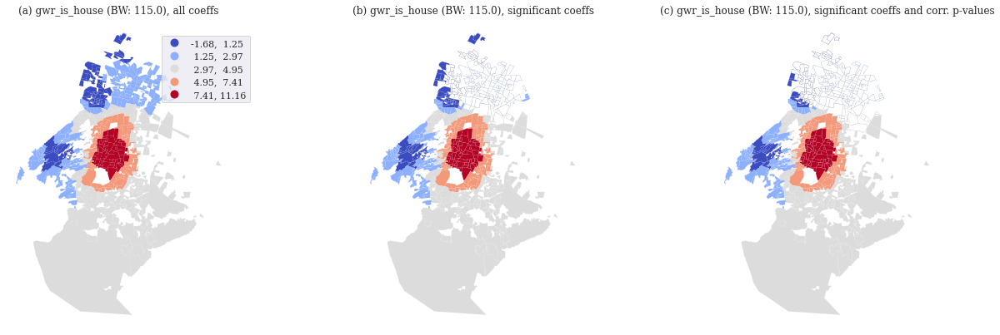

...

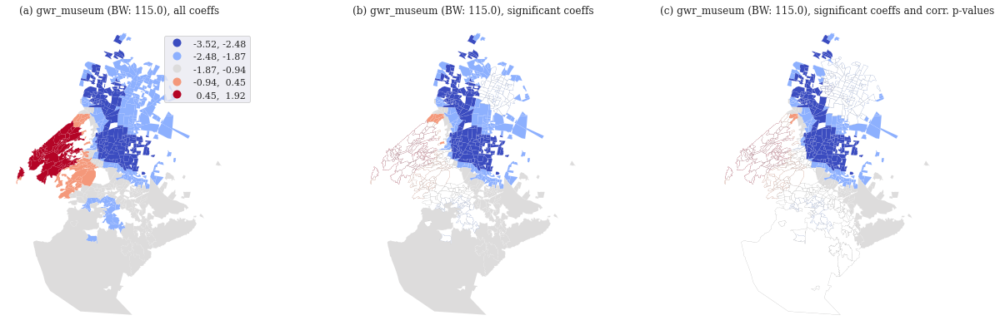

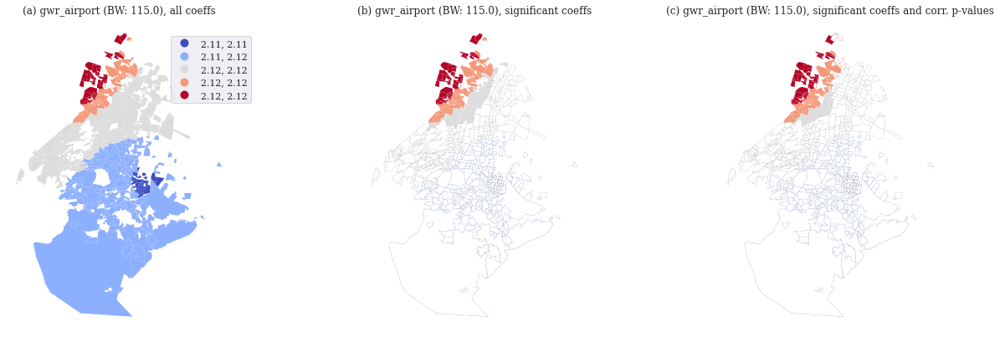

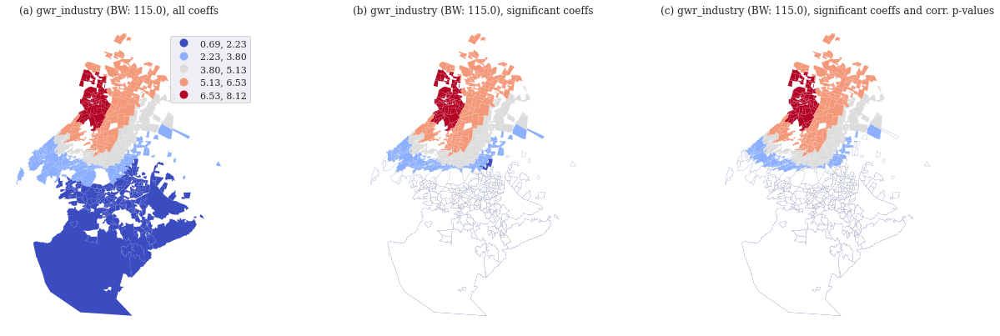

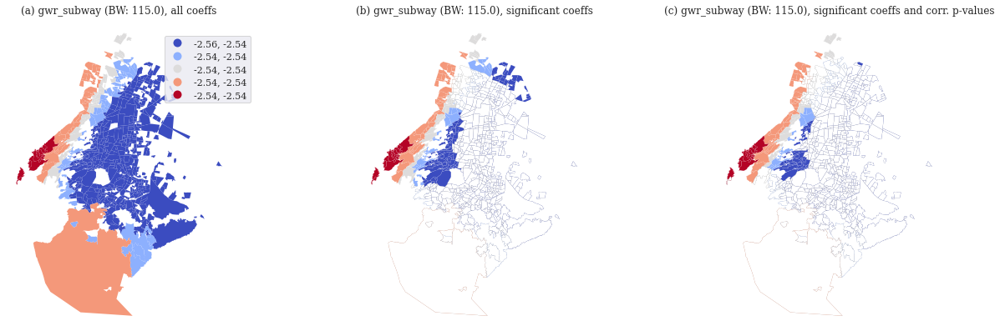

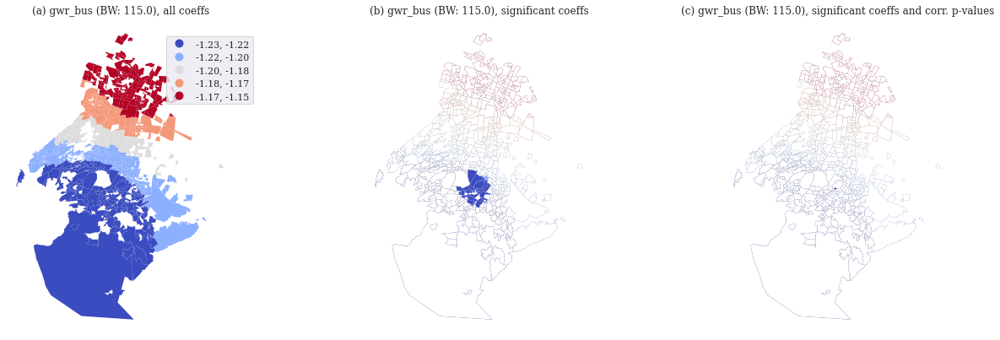

In [203]:
for num,col in enumerate (coef_names):

    try:
        fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(18,6))

        gdf_mr.plot(column= col, cmap = 'coolwarm', linewidth=0.01, scheme = 'FisherJenks', k=5, legend=True, legend_kwds={'bbox_to_anchor':(1.10, 0.96)},  ax=axes[0])

        gdf_mr.plot(column= col, cmap = 'coolwarm', linewidth=0.05, scheme = 'FisherJenks', k=5, legend=False, legend_kwds={'bbox_to_anchor':(1.10, 0.96)},  ax=axes[1])
        gdf_mr[gwr_filtered_t[:,num+1] == 0].plot(color='white', linewidth=0.05, edgecolor='black', ax=axes[1])


        gdf_mr.plot(column= col, cmap = 'coolwarm', linewidth=0.05, scheme = 'FisherJenks', k=5, legend=False, legend_kwds={'bbox_to_anchor':(1.10, 0.96)},  ax=axes[2])
        gdf_mr[gwr_filtered_tc[:,num+1] == 0].plot(color='white', linewidth=0.05, edgecolor='black', ax=axes[2])

        plt.tight_layout()

        axes[0].axis("off")
        axes[1].axis("off")
        axes[2].axis("off")

        axes[0].set_title('(a) '+ col +' (BW: ' + str(gwr_bw) +'), all coeffs', fontsize=12)
        axes[1].set_title('(b) '+ col+' (BW: ' + str(gwr_bw) +'), significant coeffs',     fontsize=12)
        axes[2].set_title('(c) '+col +' (BW: ' + str(gwr_bw) +'), significant coeffs and corr. p-values',     fontsize=12)
        plt.show()
    except:
        pass

# Test spatial stationarity

In [204]:
%%time
# Monte Carlo test of spatial variability: 10 iterations 
mgwr_p_values_stationarity = mgwr_results.spatial_variability(mgwr_selector, 10)

Backfitting:   0%|          | 0/200 [00:00<?, ?it/s]

Backfitting:   0%|          | 0/200 [00:00<?, ?it/s]

Backfitting:   0%|          | 0/200 [00:00<?, ?it/s]

Backfitting:   0%|          | 0/200 [00:00<?, ?it/s]

Backfitting:   0%|          | 0/200 [00:00<?, ?it/s]

Backfitting:   0%|          | 0/200 [00:00<?, ?it/s]

Backfitting:   0%|          | 0/200 [00:00<?, ?it/s]

Backfitting:   0%|          | 0/200 [00:00<?, ?it/s]

Backfitting:   0%|          | 0/200 [00:00<?, ?it/s]

Backfitting:   0%|          | 0/200 [00:00<?, ?it/s]

CPU times: user 16h 3min 28s, sys: 10min 50s, total: 16h 14min 19s
Wall time: 4h 21min 27s


In [205]:
df = pd.DataFrame(mgwr_p_values_stationarity[1:]).T
df.columns =  coef_names
df

,gwr_bedrooms,gwr_bathrooms,gwr_half_bathrooms,gwr_lot_size,gwr_is_house,gwr_real_age,gwr_balcony,gwr_water strorage,gwr_air_conditioning,gwr_pool,gwr_furniture,gwr_accasible_for_handicap,gwr_first_floor,gwr_security,gwr_parking_space,gwr_kitchen,gwr_garden,gwr_roof_Garden,gwr_service_room,gwr_gated_community,gwr_high_impact/area,gwr_low_impact/area,gwr_parks,gwr_schools,gwr_university,gwr_hospital,gwr_sport_facility,gwr_supermarket,gwr_mall,gwr_stadium,gwr_historic,gwr_museum,gwr_airport,gwr_industry,gwr_subway,gwr_bus
0,0.8,0.2,0.0,0.0,0.0,0.4,1.0,1.0,0.9,0.8,0.2,0.5,0.8,0.3,0.7,0.1,0.7,1.0,0.4,0.3,0.6,0.1,0.3,0.8,0.8,0.3,0.6,0.9,0.3,0.2,0.6,0.0,1.0,0.0,0.9,0.2


In [206]:
cols_variation = df.columns[(df < 0.05).any()]
print("cols with spatial variability: ",cols_variation )

cols with spatial variability:  Index(['gwr_half_bathrooms', 'gwr_lot_size', 'gwr_is_house', 'gwr_museum',
       'gwr_industry'],
      dtype='object')


# Test Local multicollinearity

In [207]:
mgwrCN, mgwrVDP = mgwr_results.local_collinearity()


In [208]:
gdf_mr['mgwr_CN'] = mgwrCN

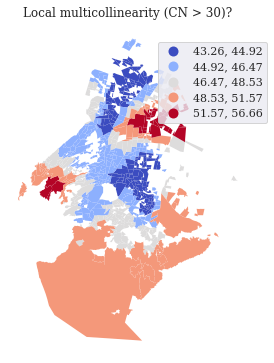

In [209]:
fig, ax = plt.subplots(figsize=(6, 6))
gdf_mr.plot(column='mgwr_CN', cmap = 'coolwarm', linewidth=0.01, scheme = 'FisherJenks', k=5, legend=True, legend_kwds={'bbox_to_anchor':(1.10, 0.96)},  ax=ax)
ax.set_title('Local multicollinearity (CN > 30)?', fontsize=12)
ax.axis("off")
#plt.savefig('myMap.png',dpi=150, bbox_inches='tight')
plt.show()

# Main Reference:
https://deepnote.com/@carlos-mendez/PYTHON-GWR-and-MGWR-71dd8ba9-a3ea-4d28-9b20-41cc8a282b7a